# Capstone Project | Finance and Risk Analytics Problem Statement
___

## Business Case
Your task is to provide consultation to two different investors, Mr. Patrick Jyenger and Mr. Peter Jyenger based on their requirements and financial objectives. The image below summarizes the profile of the two investors:

![](Investor_Profile.jpeg)

**Following points summarise the expected tasks in the assignment:**
- You must use the elements of technical analysis to understand the trend of the underlying stocks. The metrics associated with risk and returns must help you realise whether the security meets the criteria of your investor’s financial goals.
- You must use the metrics and the visualisations to compare the performance of the available securities against each other, and also against the market index, S&P500.
- The findings should be aligned with the investor persona to select the appropriate stocks for the portfolio.
- After the selection of stocks, the portfolio must be validated using the active investment strategy to estimate the prices in future. You must check if the portfolio has the potential to fulfil the financial goals set by the investor.

**You are provided with the following information for 24 stocks of leading companies listed in New York Stock Exchange(NYSE):**
- Date
- Open price: Price of stock at the start of the day
- Close price: Price of stock at the end of the day
- High price: Highest price reached by the stock on that day
- Low price: Lowest price reached by the stock on that day
- Adjusted close price: Stock price adjusted to include the annual returns (dividends) that the company offers to the shareholders
- Volume traded: Number of stocks traded on the day

**The information for every stock ranges from 1st October 2010 to 30th September 2020.**

**The stocks belong to different domains:**
- Technology/IT
- Travel/Aviation/Hospitality
- Banking/Financial Services and Insurance
- Pharmaceuticals/Healthcare/Life Sciences

**To help you with the market benchmark, you are given the S&P 500 index prices for the same period.**

As part of this task, you must execute your responsibilities as the portfolio manager. You must use the information about the investor to create a profile and use it along with the obtained results to create a portfolio of stocks that have the potential to meet the financial goals of both investors.

Hint: As part of the active investment strategy, try to replicate the daily gains/returns from the past five years over the future to predict the value of the selected stocks.

## Load Libraries

In [589]:
# Importing essential libraries and modules for data analysis, visualization, and machine learning
import pandas as pd                                                                                 # Library for working with structured data (e.g., CSV files)
import numpy as np                                                                                  # Library for efficient numerical computation
import matplotlib.pyplot as plt                                                                     # Plotting library for creating visualizations
import seaborn as sns                                                                               # Visualization library for drawing statistical graphics
import glob                                                                                         # Module for searching for files matching specific patterns
import pygwalker as pyg                                                                             # Custom or proprietary module (specific to your project or organization)

# Importing the Min-Max Scaler from scikit-learn for data preprocessing
from sklearn.preprocessing import MinMaxScaler                                                      # Library for machine learning algorithms and tools

## Load Dataset

In [590]:
def load_csvs_to_df(folder):
    """
    Loads all CSV files in a folder to a Pandas DataFrame.

    Parameters:
        folder (str): Path to the folder containing the CSV files.

    Returns:
        df (DataFrame): A Pandas DataFrame containing the data from all CSV files in the specified folder.
    """

    # Initialize an empty DataFrame
    df = pd.DataFrame()

    # Loop through all CSV files in the specified folder
    for file in glob.glob(f'{folder}/*.csv'):

        # Read each CSV file into a Pandas DataFrame
        df_1 = pd.read_csv(file)

        # Add a column to the DataFrame containing the ticker symbol for each file
        df_1['Ticker'] = file.split('/')[-1].replace('.csv', '')

        # Concatenate the current DataFrame with the new one
        df = pd.concat([df, df_1], axis=0, ignore_index=True)
    
    return df

In [591]:
# Read Aviation folder
aviation = load_csvs_to_df('Dataset/Aviation')

In [592]:
# Read Finance folder
finance = load_csvs_to_df('Dataset/Finance')

In [593]:
# Read Pharma/Healthcare folder
pharma = load_csvs_to_df('Dataset/Pharma_Healthcare')

In [594]:
# Read Technology folder
tech = load_csvs_to_df('Dataset/Technology')

In [595]:
# Concatenating Dataframes
stocks = pd.concat([aviation, finance, pharma, tech], axis=0, ignore_index=True)

In [596]:
# Reading Annexes
annex = pd.read_csv('Dataset/Annexure-I.csv')

In [597]:
annex.head()

,Ticker,Industry,Company Name
0,AAL,Aviation,American Airlines Group Inc
1,ALGT,Aviation,Allegiant Travel Company
2,ALK,Aviation,Alaska Air Group Inc
3,DAL,Aviation,Delta Air Lines Inc
4,HA,Aviation,Hawaiian Holdings Inc


In [598]:
# Merging Annex with Stocks data
stocks = stocks.merge(annex, on='Ticker', how='left')

In [599]:
# Converting date column to proper format
stocks['Date'] = pd.to_datetime(stocks['Date'], dayfirst=True)

### Check for missing values

In [600]:
# Calculate and display the percentage of null or missing values in the stocks DataFrame
stocks.isnull().sum() / len(stocks) * 100

Date            0.261075
Open            0.261075
High            0.261075
Low             0.261075
Close           0.261075
Adj Close       0.261075
Volume          0.261075
Ticker          0.000000
Industry        0.000000
Company Name    0.000000
dtype: float64

The percentage of missing values is less than 1% (0.2%). Hence, we can drop the null values.

In [601]:
# Checking rows where Date in blank
stocks[stocks['Date'].isnull()]

,Date,Open,High,Low,Close,Adj Close,Volume,Ticker,Industry,Company Name
2517,NaT,NaN,NaN,NaN,NaN,NaN,NaN,HA,Aviation,Hawaiian Holdings Inc
2518,NaT,NaN,NaN,NaN,NaN,NaN,NaN,HA,Aviation,Hawaiian Holdings Inc
2519,NaT,NaN,NaN,NaN,NaN,NaN,NaN,HA,Aviation,Hawaiian Holdings Inc
2520,NaT,NaN,NaN,NaN,NaN,NaN,NaN,HA,Aviation,Hawaiian Holdings Inc
2521,NaT,NaN,NaN,NaN,NaN,NaN,NaN,HA,Aviation,Hawaiian Holdings Inc
...,...,...,...,...,...,...,...,...,...,...
58763,NaT,NaN,NaN,NaN,NaN,NaN,NaN,GOOG,Technology,Alphabet
58764,NaT,NaN,NaN,NaN,NaN,NaN,NaN,GOOG,Technology,Alphabet
58765,NaT,NaN,NaN,NaN,NaN,NaN,NaN,GOOG,Technology,Alphabet
58766,NaT,NaN,NaN,NaN,NaN,NaN,NaN,GOOG,Technology,Alphabet


In [602]:
# Removing blank rows/columns
stocks.dropna(inplace=True)

In [603]:
# Reading S&P500 dataset
sp500 = pd.read_csv('Dataset/S&P500.csv')

In [604]:
# Converting date column to proper format
sp500['Date'] = pd.to_datetime(sp500['Date'], dayfirst=True)

In [605]:
# Creating dummy columns to ensure proper concatenating
sp500['Ticker'] = 'S&P500'
sp500['Industry'] = 'S&P500'
sp500['Company Name'] = 'S&P500'

In [606]:
# Display random 1o rows
sp500.sample(10)

,Date,Open,High,Low,Close,Adj Close,Volume,Ticker,Industry,Company Name
413,2012-05-22,1316.089966,1328.489990,1310.040039,1316.630005,1316.630005,4123680000,S&P500,S&P500,S&P500
2102,2019-02-08,2692.360107,2708.070068,2681.830078,2707.879883,2707.879883,3622330000,S&P500,S&P500,S&P500
874,2014-03-25,1859.479980,1871.869995,1855.959961,1865.619995,1865.619995,3200560000,S&P500,S&P500,S&P500
1210,2015-07-24,2102.239990,2106.010010,2077.090088,2079.649902,2079.649902,3870040000,S&P500,S&P500,S&P500
2417,2020-05-11,2915.459961,2944.250000,2903.439941,2930.189941,2930.189941,4807320000,S&P500,S&P500,S&P500
2475,2020-08-03,3288.260010,3302.729980,3284.530029,3294.610107,3294.610107,4643640000,S&P500,S&P500,S&P500
254,2011-10-04,1097.420044,1125.119995,1074.770020,1123.949951,1123.949951,3714670000,S&P500,S&P500,S&P500
1584,2017-01-18,2269.139893,2272.010010,2263.350098,2271.889893,2271.889893,3315250000,S&P500,S&P500,S&P500
1777,2017-10-23,2578.080078,2578.290039,2564.330078,2564.979980,2564.979980,3211710000,S&P500,S&P500,S&P500
484,2012-08-31,1400.069946,1413.089966,1398.959961,1406.579956,1406.579956,2938250000,S&P500,S&P500,S&P500


In [607]:
# Display information on S&P500 dataframe
sp500.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2517 entries, 0 to 2516
Data columns (total 10 columns):
 #   Column        Non-Null Count  Dtype         
---  ------        --------------  -----         
 0   Date          2517 non-null   datetime64[ns]
 1   Open          2517 non-null   float64       
 2   High          2517 non-null   float64       
 3   Low           2517 non-null   float64       
 4   Close         2517 non-null   float64       
 5   Adj Close     2517 non-null   float64       
 6   Volume        2517 non-null   int64         
 7   Ticker        2517 non-null   object        
 8   Industry      2517 non-null   object        
 9   Company Name  2517 non-null   object        
dtypes: datetime64[ns](1), float64(5), int64(1), object(3)
memory usage: 196.8+ KB


In [608]:
# Concat Individual stocks and S&P500
stocks = pd.concat([stocks, sp500], axis=0, ignore_index=True)

In [609]:
# Keeping only the Date, Ticker and Close value
stocks = stocks[['Ticker', 'Date', 'Close']].copy()

In [610]:
# Calculate and assign to the variable last_5_years a timedelta object representing the last 5 years, in terms of days
last_5_years = pd.to_timedelta((365 * 5) + 1, unit='D')                                                 # Adding 1 day considering for an extra day of a leap year
last_5_years

Timedelta('1826 days 00:00:00')

In [611]:
# Considering stock values only for the last 5 Years
stocks = stocks.loc[stocks['Date'] >= stocks['Date'].max() - last_5_years]

### Check for Outliers

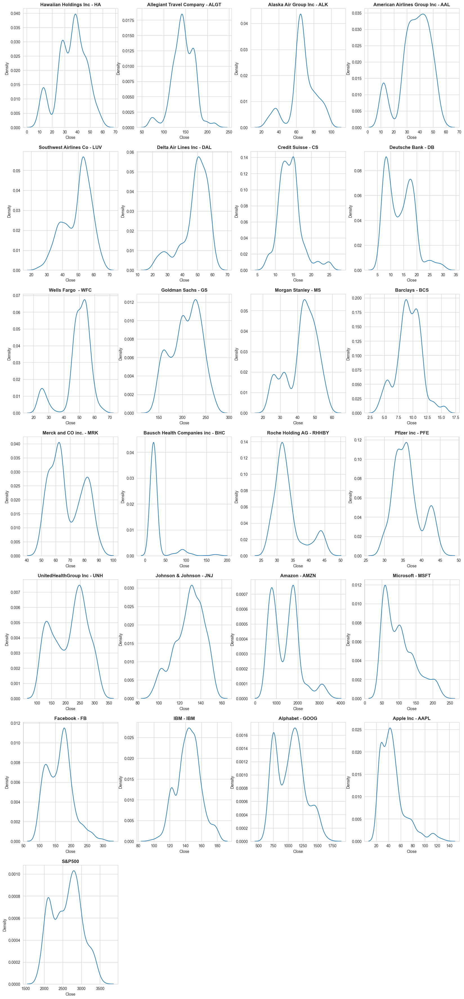

In [612]:
i = 0

# Initialize a figure with a size of 20x45 inches
plt.figure(figsize=(20, 45))

# Loop through each ticker symbol in the list and create a subplot for it
for ticker in stocks['Ticker'].drop_duplicates().to_list():                                 # Create a list of unique tickers in the dataset
    i+=1

    # Create a subplot with 7 rows and 4 columns
    plt.subplot(7, 4, i)

    # Plot the KDE (kernel density estimate) of the Close column for each ticker symbol
    sns.kdeplot(data=stocks[stocks['Ticker'] == ticker], x='Close')

    # Set the title of the subplot to the ticker symbol
    try:
        ticker = f'{annex.loc[annex['Ticker'] == ticker, 'Company Name'].values[0]} - {ticker}'
    except IndexError:
        pass

    plt.title(ticker, fontweight='bold')

# Show the plot
plt.show()

i = 0

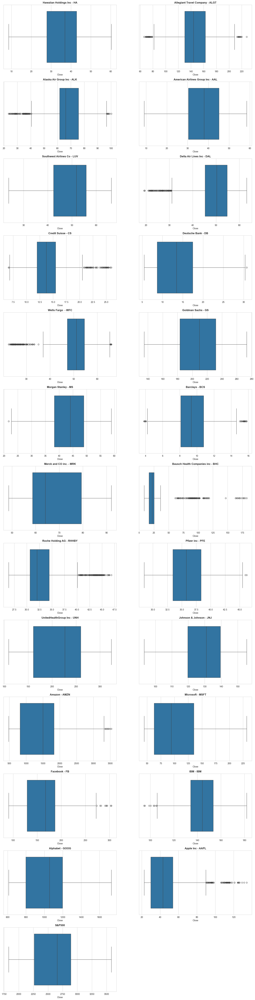

In [613]:
# Initialize a figure with a size of 20x80 inches
plt.figure(figsize=(20, 80))

# Loop through each ticker symbol in the list and create a subplot for i
for ticker in stocks['Ticker'].drop_duplicates().to_list():                             # Create a list of unique tickers in the dataset
    i+=1

    # Create a subplot with 13 rows and 2 columns
    plt.subplot(13, 2, i)

    # Plot the boxplot of the Close column for each ticker symbol
    sns.boxplot(data=stocks[stocks['Ticker'] == ticker], x='Close')

    # Set the title of the subplot to the ticker symbol
    try:
        ticker = f'{annex.loc[annex['Ticker'] == ticker, 'Company Name'].values[0]} - {ticker}'
    except IndexError:
        pass

    plt.title(ticker, fontweight='bold')

# Show the plot
plt.show()

i=0

### Stocks with Outliers

In [614]:
# List of tickers with outliers
stocks_with_outliers = ['ALGT', 'ALK', 'DAL', 'CS', 'DB', 'WFC', 'BCS', 'BHC', 'RHHBY', 'PFE', 'AMZN', 'FB', 'IBM', 'AAPL']

# Create a Pandas DataFrame with the list of tickers as its only column
stocks_with_outliers = pd.DataFrame(stocks_with_outliers, columns=['Ticker'])

# Merge the stock data with the annex data on the 'Ticker' column using a left join
stocks_with_outliers = stocks_with_outliers.merge(annex, on='Ticker', how='left')

# Print the first 5 rows of the resulting DataFrame
stocks_with_outliers.head()

,Ticker,Industry,Company Name
0,ALGT,Aviation,Allegiant Travel Company
1,ALK,Aviation,Alaska Air Group Inc
2,DAL,Aviation,Delta Air Lines Inc
3,CS,Finance,Credit Suisse
4,DB,Finance,Deutsche Bank


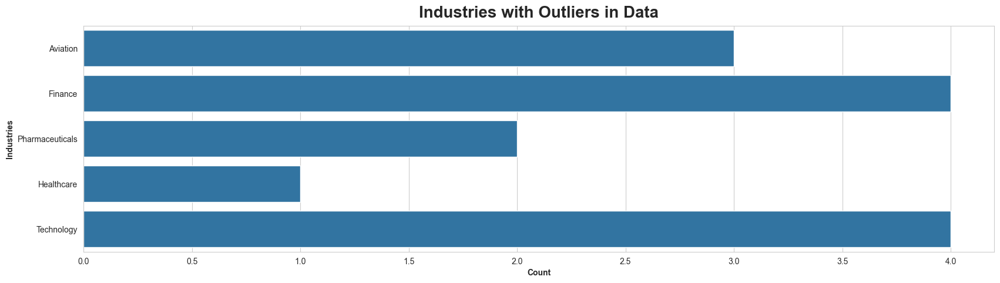

In [615]:
# Initialize a figure with a size of 20x10 inches
plt.figure(figsize=(20, 5))

# Chart showing industries with outliers in data
sns.countplot(stocks_with_outliers['Industry'])

# Set the title of the subplot to the industry name
plt.title('Industries with Outliers in Data', fontweight='bold', fontsize=20, pad=10)

# Set the x-axis label to "Count" in bold font
plt.xlabel('Count', fontweight='bold')

# Set the y-axis label to "Industries" in bold font
plt.ylabel('Industries', fontweight='bold')

# Show the plot
plt.show()

### Remarks:
Below stocks have Outliers,
- **ALGT**: Allegiant Travel Company
- **ALK**: Alaska Air Group Inc
- **DAL**: Delta Air Lines Inc
- **CS**: Credit Suisse
- **DB**: Deutsche Bank
- **WFC**: Wells Fargo
- **BCS**: Barclays
- **BHC**: Bausch Health Companies inc
- **RHHBY**: Roche Holding AG
- **PFE**: Pfizer inc
- **AMZN**: Amazon
- **FB**: Facebook
- **IBM**: International Business Machine (IBM)
- **AAPL**: Apple Inc

Majority of the outliers are in Technology, Finance and Aviation industry.

In [616]:
# Converting stocks data to wide-data format
stocks = stocks.pivot_table(
    index='Date', 
    columns='Ticker', 
    values='Close'
)

In [617]:
# Create a list of 10 random rows from the dataset
stocks.sample(n=10)

Ticker,AAL,AAPL,ALGT,ALK,AMZN,BCS,BHC,CS,DAL,DB,...,JNJ,LUV,MRK,MS,MSFT,PFE,RHHBY,S&P500,UNH,WFC
Date,,,,,,,,,,,,,,,,,,,,,
2019-09-17,28.639999,55.174999,151.520004,64.919998,1822.550049,7.48,23.080000,12.780000,59.369999,8.19,...,129.669998,55.730000,82.510002,44.209999,137.389999,36.500000,35.180000,3005.699951,232.520004,48.759998
2019-07-23,33.730000,52.209999,147.660004,65.099998,1994.489990,7.91,23.650000,12.610000,63.090000,7.95,...,128.839996,54.119999,82.029999,45.099998,139.289993,43.090000,33.930000,3005.469971,255.009995,47.200001
2018-11-21,36.310001,44.195000,121.029999,68.519997,1516.729980,8.46,23.110001,11.960000,55.970001,9.44,...,141.990005,52.250000,74.790001,43.730000,103.110001,43.099998,31.020000,2649.929932,260.549988,52.430000
2016-10-26,39.320000,28.897499,153.949997,71.129997,822.590027,8.85,21.840000,13.890000,41.400002,14.56,...,114.559998,38.400002,60.869999,33.590000,60.630001,32.400002,28.360001,2139.429932,142.229996,46.150002
2018-12-26,32.290001,39.292500,104.110001,60.790001,1470.900024,7.42,18.850000,10.800000,50.410000,8.16,...,126.709999,46.720001,74.000000,39.299999,100.559998,42.189999,30.650000,2467.699951,243.350006,45.590000
2018-10-30,34.660000,53.325001,118.690002,63.240002,1530.420044,8.68,22.190001,12.810000,55.119999,9.74,...,140.750000,49.150002,72.870003,44.500000,103.730003,42.889999,29.900000,2682.629883,258.279999,52.689999
2017-03-23,41.410000,35.230000,161.050003,94.050003,847.380005,11.23,10.860000,14.570000,45.919998,16.91,...,125.900002,52.369999,63.279999,42.590000,64.870003,34.290001,31.730000,2345.959961,165.289993,55.250000
2019-08-27,24.450001,51.040001,138.820007,58.009998,1761.829956,6.66,20.980000,11.310000,56.139999,7.13,...,129.639999,50.490002,85.519997,39.790001,135.740005,34.340000,34.459999,2869.159912,222.929993,44.750000
2017-12-19,51.439999,43.634998,153.149994,73.190002,1187.380005,10.85,20.860001,17.780001,55.750000,19.85,...,141.779999,65.919998,56.230000,52.930000,85.830002,36.939999,30.969999,2681.469971,222.039993,60.360001


In [618]:
# Print information about the DataFrame, including its shape, columns, and data types
stocks.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1259 entries, 2015-10-01 to 2020-09-30
Data columns (total 25 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   AAL     1259 non-null   float64
 1   AAPL    1259 non-null   float64
 2   ALGT    1259 non-null   float64
 3   ALK     1259 non-null   float64
 4   AMZN    1259 non-null   float64
 5   BCS     1259 non-null   float64
 6   BHC     1259 non-null   float64
 7   CS      1259 non-null   float64
 8   DAL     1259 non-null   float64
 9   DB      1259 non-null   float64
 10  FB      1259 non-null   float64
 11  GOOG    1259 non-null   float64
 12  GS      1259 non-null   float64
 13  HA      1259 non-null   float64
 14  IBM     1259 non-null   float64
 15  JNJ     1259 non-null   float64
 16  LUV     1259 non-null   float64
 17  MRK     1259 non-null   float64
 18  MS      1259 non-null   float64
 19  MSFT    1259 non-null   float64
 20  PFE     1259 non-null   float64
 21  RHHBY   1259 non-nu

## Export cleaned dataset to a New Excel file

In [619]:
# Class for writing DataFrame objects into excel sheets
final_data = pd.ExcelWriter('Export/Final Data.xlsx')

# Save stocks data to 'Stock Data' worksheet
stocks.to_excel(final_data, sheet_name='Stock Data')

## Exploratory Data Analysis

### Data Normalization

In [620]:
# Performing MinMaxScaler
scaler = MinMaxScaler()

In [621]:
# Calculating the values and applying the values of the parameters on the actual data and gives the normalized value
normalized_stocks = scaler.fit_transform(stocks)

In [622]:
# Converting numpy array to DataFrame and setting column names and index
normalized_stocks = pd.DataFrame(normalized_stocks, columns=stocks.columns, index=stocks.index)

In [623]:
# Print the first 5 rows of the DataFrame
normalized_stocks.head()

Ticker,AAL,AAPL,ALGT,ALK,AMZN,BCS,BHC,CS,DAL,DB,...,JNJ,LUV,MRK,MS,MSFT,PFE,RHHBY,S&P500,UNH,WFC
Date,,,,,,,,,,,,,,,,,,,,,
2015-10-01,0.610156,0.043102,0.938873,0.739045,0.012675,0.933166,0.984351,0.903059,0.596316,0.832608,...,0.000000,0.342763,0.017952,0.263568,0.000000,0.188839,0.333985,0.054083,0.034410,0.666129
2015-10-02,0.598624,0.044894,0.924086,0.726395,0.016551,0.964912,1.000000,0.931571,0.584035,0.857143,...,0.012191,0.342056,0.035673,0.261687,0.005133,0.258737,0.338875,0.069804,0.044761,0.661982
2015-10-05,0.630184,0.045791,0.926994,0.747913,0.020204,0.982456,0.891491,0.958528,0.631567,0.899090,...,0.025505,0.363743,0.060759,0.284793,0.010800,0.281285,0.344743,0.090178,0.048585,0.688479
2015-10-06,0.588509,0.046978,0.880839,0.664710,0.018171,0.978279,0.906104,0.969933,0.589038,0.907004,...,0.004010,0.333098,0.027848,0.286674,0.011441,0.242390,0.349144,0.086108,0.031799,0.679723
2015-10-07,0.612381,0.045791,0.913259,0.683490,0.019633,0.993317,0.928140,0.966822,0.609507,0.922438,...,0.029034,0.349835,0.054315,0.301988,0.011709,0.270575,0.301222,0.095190,0.033571,0.683410


In [624]:
# Export the normalized stock data to the excel file
normalized_stocks.to_excel(final_data, sheet_name='Stock Data - Normalized')

## Visualization

### Company Wise Analysis

In [625]:
# Reset the index of the DataFrame to make Date the row labels
# Melt the DataFrame from wide to long format, with Date as the id variable, Ticker as the variable name, and Close as the value name
stocks_1 = pd.melt(stocks.reset_index(), id_vars='Date', var_name='Ticker', value_name='Close')

In [626]:
# Print information about the DataFrame, including its shape, columns, and data types
stocks_1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 31475 entries, 0 to 31474
Data columns (total 3 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   Date    31475 non-null  datetime64[ns]
 1   Ticker  31475 non-null  object        
 2   Close   31475 non-null  float64       
dtypes: datetime64[ns](1), float64(1), object(1)
memory usage: 737.8+ KB


In [627]:
# Create a Pyg visualization specification from a string
vis_spec = r"""{"config":[{"config":{"defaultAggregated":true,"geoms":["auto"],"coordSystem":"generic","limit":-1,"timezoneDisplayOffset":0},"encodings":{"dimensions":[{"fid":"Date","name":"Date","basename":"Date","semanticType":"temporal","analyticType":"dimension","offset":0},{"fid":"Ticker","name":"Ticker","basename":"Ticker","semanticType":"nominal","analyticType":"dimension","offset":0},{"fid":"gw_mea_key_fid","name":"Measure names","analyticType":"dimension","semanticType":"nominal"}],"measures":[{"fid":"Close","name":"Close","basename":"Close","analyticType":"measure","semanticType":"quantitative","aggName":"sum","offset":0},{"fid":"gw_count_fid","name":"Row count","analyticType":"measure","semanticType":"quantitative","aggName":"sum","computed":true,"expression":{"op":"one","params":[],"as":"gw_count_fid"}},{"fid":"gw_mea_val_fid","name":"Measure values","analyticType":"measure","semanticType":"quantitative","aggName":"sum"}],"rows":[{"fid":"Close","name":"Close","basename":"Close","analyticType":"measure","semanticType":"quantitative","aggName":"sum","offset":0}],"columns":[{"fid":"Date","name":"Date","basename":"Date","semanticType":"temporal","analyticType":"dimension","offset":0}],"color":[{"fid":"Ticker","name":"Ticker","basename":"Ticker","semanticType":"nominal","analyticType":"dimension","offset":0}],"opacity":[],"size":[],"shape":[],"radius":[],"theta":[],"longitude":[],"latitude":[],"geoId":[],"details":[],"filters":[{"fid":"Ticker","name":"Ticker","basename":"Ticker","semanticType":"nominal","analyticType":"dimension","offset":0,"rule":{"type":"not in","value":["S&P500"]}}],"text":[]},"layout":{"showActions":false,"showTableSummary":false,"stack":"stack","interactiveScale":false,"zeroScale":true,"size":{"mode":"full","width":320,"height":200},"format":{},"geoKey":"name","resolve":{"x":false,"y":false,"color":false,"opacity":false,"shape":false,"size":false}},"visId":"gw_ix0v","name":"Chart 1"}],"chart_map":{},"workflow_list":[{"workflow":[{"type":"filter","filters":[{"fid":"Ticker","rule":{"type":"not in","value":["S&P500"]}}]},{"type":"view","query":[{"op":"aggregate","groupBy":["Date","Ticker"],"measures":[{"field":"Close","agg":"sum","asFieldKey":"Close_sum"}]}]}]}],"version":"0.4.8.1"}"""

# Walk the Pyg visualization specification using the stocks_1 DataFrame
pyg.walk(stocks_1, spec=vis_spec)

Box(children=(HTML(value='<div id="ifr-pyg-00061a8c150eed6cKvWX34VsfSh6J2rN" style="height: auto">\n    <head>…

In [628]:
# First, let's find the minimum and maximum dates in the DataFrame.
min_date = stocks_1['Date'].min()
max_date = stocks_1['Date'].max()

In [629]:
# Create a new DataFrame that excludes rows where the Ticker value is "S&P500"
stocks_exc_sp500 = stocks_1.loc[stocks_1['Ticker'] != 'S&P500']

In [630]:
# Calculate the difference in prices between the minimum dates for each stock
price_diff = stocks_exc_sp500.loc[stocks_exc_sp500['Date'] == min_date, ['Ticker', 'Close']]

In [631]:
price_diff = price_diff.merge(stocks_exc_sp500.loc[stocks_exc_sp500['Date'] == max_date, ['Ticker', 'Close']], on='Ticker', how='left')

In [632]:
# Rename the columns for clarity
price_diff.columns = ['Stock', 'Start Price', 'End Price']

In [633]:
# Calculate the percentage difference between the start and end prices
price_diff['Percentage Difference'] = (price_diff['End Price'] - price_diff['Start Price']) / price_diff['Start Price'] * 100

In [634]:
# Sort the DataFrame by the percentage difference in descending order to get the top stocks with the largest increase in price
price_diff.sort_values(by='Percentage Difference', ascending=False)

,Stock,Start Price,End Price,Percentage Difference
4,AMZN,520.719971,3148.729980,504.687770
19,MSFT,44.610001,210.330002,371.486208
1,AAPL,27.395000,115.809998,322.741369
10,FB,90.949997,261.899994,187.960421
22,UNH,116.610001,311.769989,167.361278
11,GOOG,611.289978,1469.599976,140.409630
17,MRK,49.369999,82.949997,68.017012
15,JNJ,93.169998,148.880005,59.793934
18,MS,31.500000,48.349998,53.492057
21,RHHBY,33.220001,42.810001,28.868151


In [635]:
# Create a new DataFrame - stocks_2
stocks_2 = pd.melt(normalized_stocks.reset_index(), id_vars='Date', var_name='Ticker', value_name='Close')

In [636]:
# Create a Pyg visualization specification from a string
vis_spec = r"""{"config":[{"config":{"defaultAggregated":true,"geoms":["auto"],"coordSystem":"generic","limit":-1,"timezoneDisplayOffset":0},"encodings":{"dimensions":[{"fid":"Date","name":"Date","basename":"Date","semanticType":"temporal","analyticType":"dimension","offset":0},{"fid":"Ticker","name":"Ticker","basename":"Ticker","semanticType":"nominal","analyticType":"dimension","offset":0},{"fid":"gw_mea_key_fid","name":"Measure names","analyticType":"dimension","semanticType":"nominal"}],"measures":[{"fid":"Close","name":"Close","basename":"Close","analyticType":"measure","semanticType":"quantitative","aggName":"sum","offset":0},{"fid":"gw_count_fid","name":"Row count","analyticType":"measure","semanticType":"quantitative","aggName":"sum","computed":true,"expression":{"op":"one","params":[],"as":"gw_count_fid"}},{"fid":"gw_mea_val_fid","name":"Measure values","analyticType":"measure","semanticType":"quantitative","aggName":"sum"}],"rows":[{"fid":"Close","name":"Close","basename":"Close","analyticType":"measure","semanticType":"quantitative","aggName":"sum","offset":0}],"columns":[{"fid":"Date","name":"Date","basename":"Date","semanticType":"temporal","analyticType":"dimension","offset":0}],"color":[{"fid":"Ticker","name":"Ticker","basename":"Ticker","semanticType":"nominal","analyticType":"dimension","offset":0}],"opacity":[],"size":[],"shape":[],"radius":[],"theta":[],"longitude":[],"latitude":[],"geoId":[],"details":[],"filters":[{"fid":"Ticker","name":"Ticker","basename":"Ticker","semanticType":"nominal","analyticType":"dimension","offset":0,"rule":{"type":"one of","value":["UNH","RHHBY","AAPL","AMZN","MSFT","JNJ","FB"]}}],"text":[]},"layout":{"showActions":false,"showTableSummary":false,"stack":"stack","interactiveScale":false,"zeroScale":true,"size":{"mode":"full","width":320,"height":200},"format":{},"geoKey":"name","resolve":{"x":false,"y":false,"color":false,"opacity":false,"shape":false,"size":false}},"visId":"gw_grBb","name":"Returns above 80%"},{"config":{"defaultAggregated":true,"geoms":["auto"],"coordSystem":"generic","limit":-1,"timezoneDisplayOffset":0},"encodings":{"dimensions":[{"fid":"Date","name":"Date","basename":"Date","semanticType":"temporal","analyticType":"dimension","offset":0},{"fid":"Ticker","name":"Ticker","basename":"Ticker","semanticType":"nominal","analyticType":"dimension","offset":0},{"fid":"gw_mea_key_fid","name":"Measure names","analyticType":"dimension","semanticType":"nominal"}],"measures":[{"fid":"Close","name":"Close","basename":"Close","analyticType":"measure","semanticType":"quantitative","aggName":"sum","offset":0},{"fid":"gw_count_fid","name":"Row count","analyticType":"measure","semanticType":"quantitative","aggName":"sum","computed":true,"expression":{"op":"one","params":[],"as":"gw_count_fid"}},{"fid":"gw_mea_val_fid","name":"Measure values","analyticType":"measure","semanticType":"quantitative","aggName":"sum"}],"rows":[{"fid":"Close","name":"Close","basename":"Close","analyticType":"measure","semanticType":"quantitative","aggName":"sum","offset":0}],"columns":[{"fid":"Date","name":"Date","basename":"Date","semanticType":"temporal","analyticType":"dimension","offset":0}],"color":[{"fid":"Ticker","name":"Ticker","basename":"Ticker","semanticType":"nominal","analyticType":"dimension","offset":0}],"opacity":[],"size":[],"shape":[],"radius":[],"theta":[],"longitude":[],"latitude":[],"geoId":[],"details":[],"filters":[{"fid":"Ticker","name":"Ticker","basename":"Ticker","semanticType":"nominal","analyticType":"dimension","offset":0,"rule":{"type":"one of","value":["MS","MRK","GOOG"]}}],"text":[]},"layout":{"showActions":false,"showTableSummary":false,"stack":"stack","interactiveScale":false,"zeroScale":true,"size":{"mode":"full","width":320,"height":200},"format":{},"geoKey":"name","resolve":{"x":false,"y":false,"color":false,"opacity":false,"shape":false,"size":false}},"visId":"gw_7QCp","name":"Returns above 50%"},{"config":{"defaultAggregated":true,"geoms":["auto"],"coordSystem":"generic","limit":-1,"timezoneDisplayOffset":0},"encodings":{"dimensions":[{"fid":"Date","name":"Date","basename":"Date","semanticType":"temporal","analyticType":"dimension","offset":0},{"fid":"Ticker","name":"Ticker","basename":"Ticker","semanticType":"nominal","analyticType":"dimension","offset":0},{"fid":"gw_mea_key_fid","name":"Measure names","analyticType":"dimension","semanticType":"nominal"}],"measures":[{"fid":"Close","name":"Close","basename":"Close","analyticType":"measure","semanticType":"quantitative","aggName":"sum","offset":0},{"fid":"gw_count_fid","name":"Row count","analyticType":"measure","semanticType":"quantitative","aggName":"sum","computed":true,"expression":{"op":"one","params":[],"as":"gw_count_fid"}},{"fid":"gw_mea_val_fid","name":"Measure values","analyticType":"measure","semanticType":"quantitative","aggName":"sum"}],"rows":[{"fid":"Close","name":"Close","basename":"Close","analyticType":"measure","semanticType":"quantitative","aggName":"sum","offset":0}],"columns":[{"fid":"Date","name":"Date","basename":"Date","semanticType":"temporal","analyticType":"dimension","offset":0}],"color":[{"fid":"Ticker","name":"Ticker","basename":"Ticker","semanticType":"nominal","analyticType":"dimension","offset":0}],"opacity":[],"size":[],"shape":[],"radius":[],"theta":[],"longitude":[],"latitude":[],"geoId":[],"details":[],"filters":[{"fid":"Ticker","name":"Ticker","basename":"Ticker","semanticType":"nominal","analyticType":"dimension","offset":0,"rule":{"type":"not in","value":["MS","MRK","GOOG","AAPL","AMZN","FB","JNJ","MSFT","RHHBY","S&P500","UNH"]}}],"text":[]},"layout":{"showActions":false,"showTableSummary":false,"stack":"stack","interactiveScale":false,"zeroScale":true,"size":{"mode":"full","width":320,"height":200},"format":{},"geoKey":"name","resolve":{"x":false,"y":false,"color":false,"opacity":false,"shape":false,"size":false}},"visId":"gw_LdGc","name":"Returns less than 50%"}],"chart_map":{},"workflow_list":[{"workflow":[{"type":"filter","filters":[{"fid":"Ticker","rule":{"type":"one of","value":["UNH","RHHBY","AAPL","AMZN","MSFT","JNJ","FB"]}}]},{"type":"view","query":[{"op":"aggregate","groupBy":["Date","Ticker"],"measures":[{"field":"Close","agg":"sum","asFieldKey":"Close_sum"}]}]}]},{"workflow":[{"type":"filter","filters":[{"fid":"Ticker","rule":{"type":"one of","value":["MS","MRK","GOOG"]}}]},{"type":"view","query":[{"op":"aggregate","groupBy":["Date","Ticker"],"measures":[{"field":"Close","agg":"sum","asFieldKey":"Close_sum"}]}]}]},{"workflow":[{"type":"filter","filters":[{"fid":"Ticker","rule":{"type":"not in","value":["MS","MRK","GOOG","AAPL","AMZN","FB","JNJ","MSFT","RHHBY","S&P500","UNH"]}}]},{"type":"view","query":[{"op":"aggregate","groupBy":["Date","Ticker"],"measures":[{"field":"Close","agg":"sum","asFieldKey":"Close_sum"}]}]}]}],"version":"0.4.8.1"}"""

# Walk the Pyg visualization specification using the stocks_2 DataFrame
pyg.walk(stocks_2, spec=vis_spec)

Box(children=(HTML(value='<div id="ifr-pyg-00061a8c151524ddLkYI4QwUuZpWOgH6" style="height: auto">\n    <head>…

#### Insight
- 7 stocks have returns of more than 80% at the end of 5 years.
- 3 stocks have returns of between 50% to 80% at the end of 5 years.
- Many of the remaining stocks which showed returns of less than 50% show a dip post Mar 2020 i.e. post COVID breakdown.

### Sector wise Analysis

In [637]:
def analyze_industry(data, industry):
    """
    Function to analyze an industry by plotting its performance against S&P500 and visualizing correlation among companies

    :param data: Dataframe
    :param industry: Industry name to analyze in the Dataframe
    :return: Normalized stocks with S&P500 values and Dataframe provided
    """

    # Create a new DataFrame that includes the normalized stock data for the given industry
    df = normalized_stocks[['S&P500'] + data['Ticker'].drop_duplicates().tolist()]

    # Create a line plot to show the performance of the industry against S&P500
    plt.figure(figsize=(25, 10))                                                                                    # Set the figure size for better visualization
    sns.lineplot(data=df, palette='husl')                                                                           # Use Husl color palette for the line plot
    plt.title(f'Performance of {industry} industry against S&P500', fontweight='bold', fontsize=20, pad=15)         # Add a title to the plot
    plt.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=0.)                                                      # Customize the legend box
    plt.show()                                                                                                      # Display the plot

    # Create a heatmap to show the correlation among companies in the industry
    plt.figure(figsize=(25, 10))                                                                                    # Set the figure size for better visualization
    sns.heatmap(df.corr(), annot=True, cmap='YlGnBu')                                                               # Use YlGnBu color palette for the heatmap
    plt.title(f'Correlation of various companies in {industry} industry', fontweight='bold', fontsize=20, pad=15)   # Add a title to the plot
    plt.yticks(rotation=0)                                                                                          # Rotate the y-axis tick labels for better readability
    plt.show()                                                                                                      # Display the heatmap

    # Return the DataFrame used for plotting
    return df

#### 1. Aviation

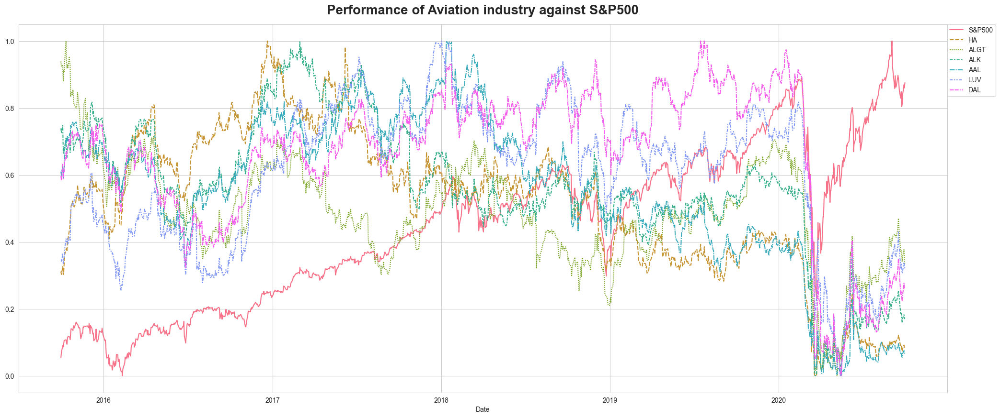

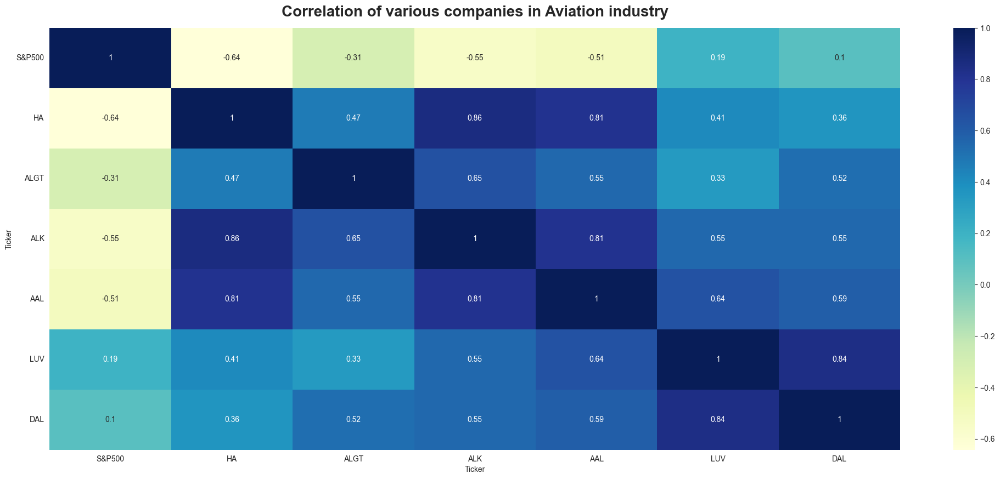

In [638]:
aviation_set = analyze_industry(aviation, 'Aviation')

##### Insight
- The Aviation industry was seriously affected in March 2020 due to the COVID-19 pandemic.
- Since then the industry is gradually rising, but the sector continues to face challenges despite a rising market index.
- The correlation matrix also demonstrates the weak and negative correlation of the companies in Aviation industry with the S&P500.
- ALK and HA show a strong correlation. LUV and DAL also show a strong correlation.

### 2. Finance

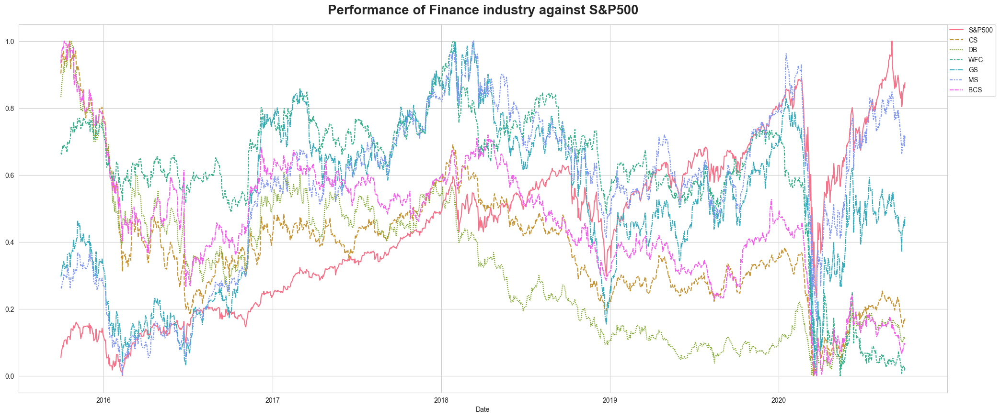

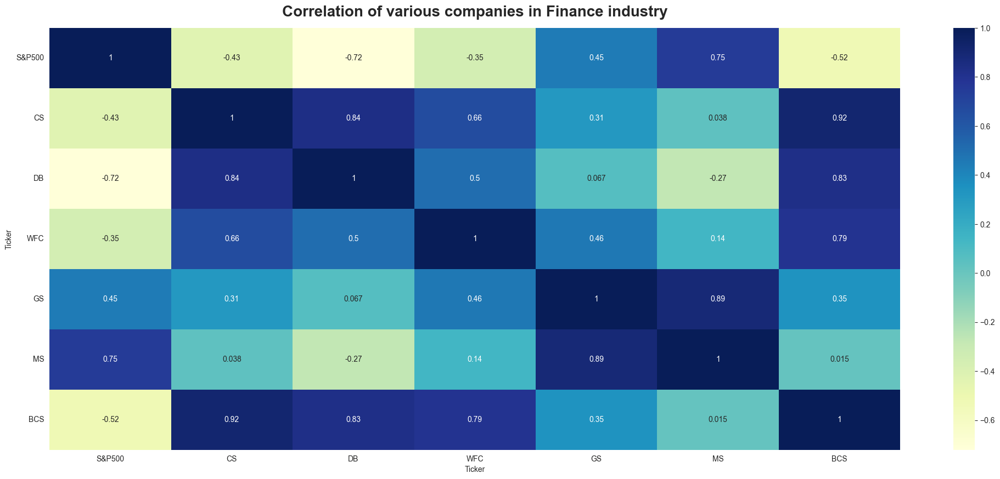

In [639]:
finance_set = analyze_industry(finance, 'Finance')

##### Insight
- The COVID-19 pandemic also affected the Finance sector.
- Although, the sector has recovered a bit, majority of its stocks has still not recovered to its pre-pandemic state.
- MS and GS are highly co-related and also have performed well when compared to other stocks.

### 3. Pharma (Healthcare)

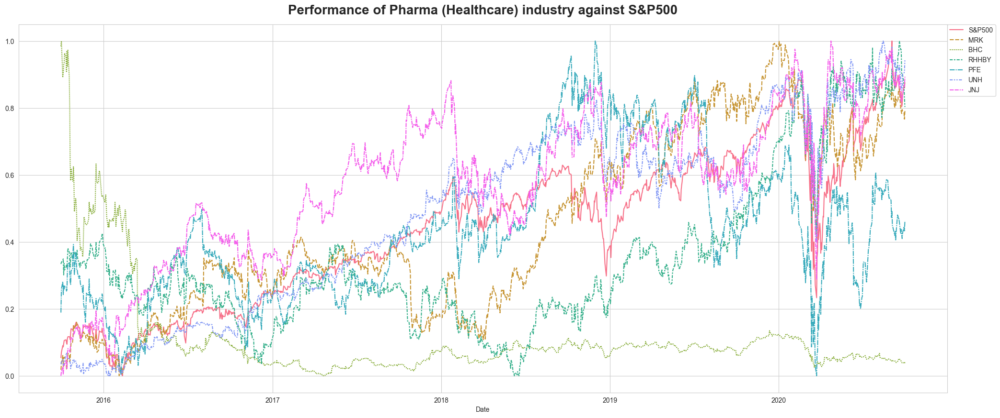

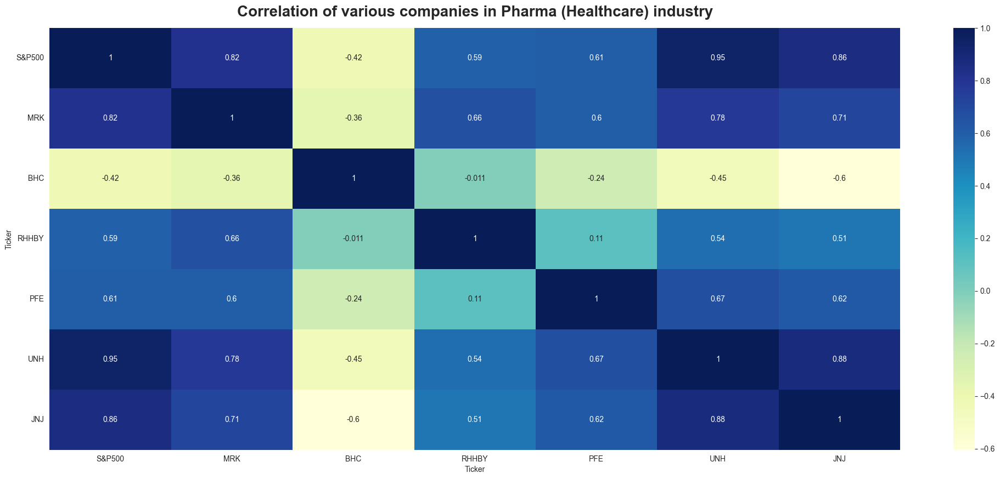

In [640]:
pharma_set = analyze_industry(pharma, 'Pharma (Healthcare)')

##### Insight
- The COVID-19 pandemic also affected the Pharma (Healthcare) sector.
- However, the sector showcased and impressive recovery.
- UNH, JNJ and MRK have performed well when compared with market index.
- BHC has consistently underperformed compared to other stocks in the same sector over the years.

### 4. Technology

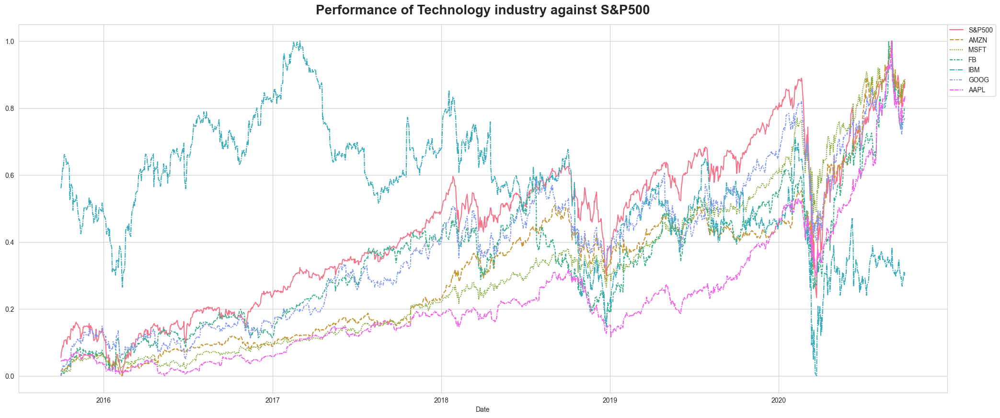

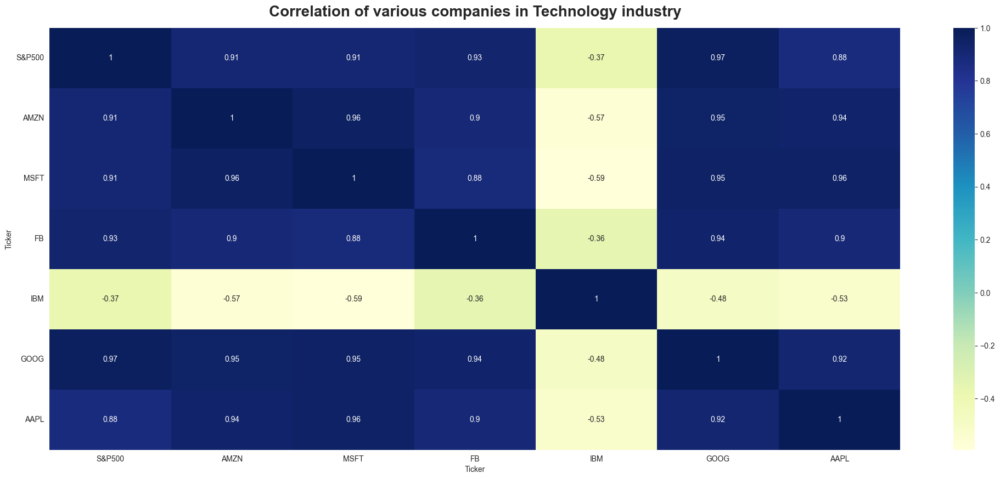

In [641]:
tech_set = analyze_industry(tech, 'Technology')

##### Insight
- The COVID-19 pandemic also affected the Technology sector.
- However, the sector showcased and impressive recovery.
- GOOG, FB, MSFT, AMZN and AAPL have performed really well when compared with the market index. All these companies are also highly correlated to each other.
- IBM has consistently underperformed compared to other stocks in the same sector over the years.

## Key Metrics

### Daily Returns

A Return, also known as a financial return, in its simplest terms, is the money made or lost on an investment over some period of time.
- A return is a percentage defined as the change of price expressed as a fraction of the initial price.
- Returns exhibit more attractive statistical properties than asset prices themselves. Therefore it also makes more statistical sense to analyze return data rather than price series.

We will use formula and pandas built in function pct_change to compute the simple returns for each day, each stock in our dataset.

In [642]:
# let's assign the dataset to daily_returns
daily_return = stocks.copy()

# Loop function to calculate the percentage change
for col in daily_return.columns:
    daily_return[col] = daily_return[col].pct_change(1)         # Percentage change between the current and a prior element

In [643]:
# Get a list of column names from the 'daily_return' object
t = daily_return.columns.to_list()

# Remove the 'S&P500' column from the list
t.remove('S&P500')

# Print the filtered list "t"
t

['AAL',
 'AAPL',
 'ALGT',
 'ALK',
 'AMZN',
 'BCS',
 'BHC',
 'CS',
 'DAL',
 'DB',
 'FB',
 'GOOG',
 'GS',
 'HA',
 'IBM',
 'JNJ',
 'LUV',
 'MRK',
 'MS',
 'MSFT',
 'PFE',
 'RHHBY',
 'UNH',
 'WFC']

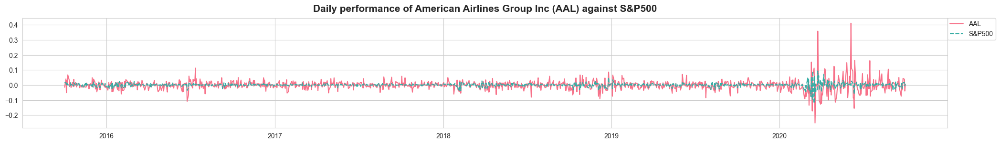

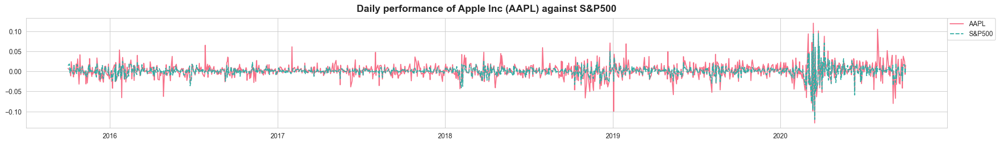

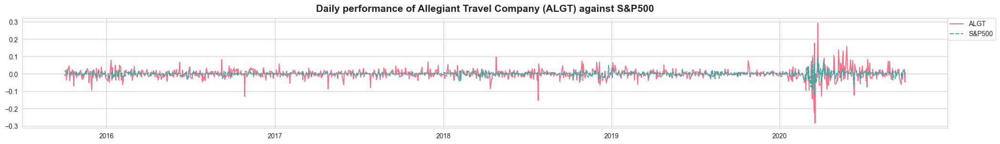

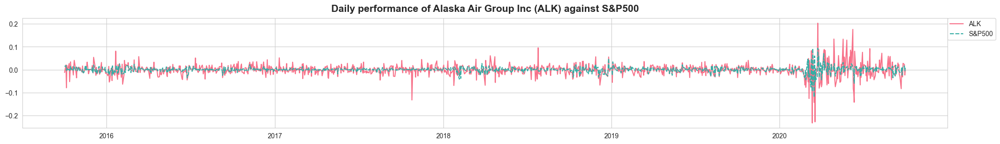

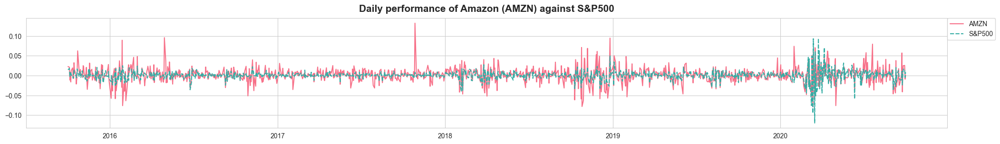

...

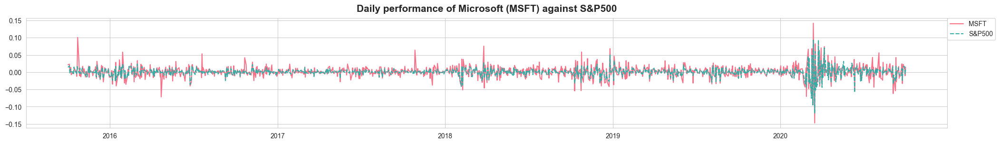

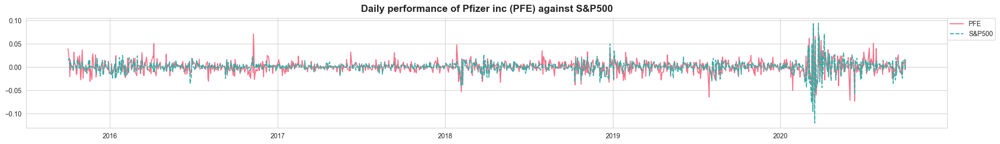

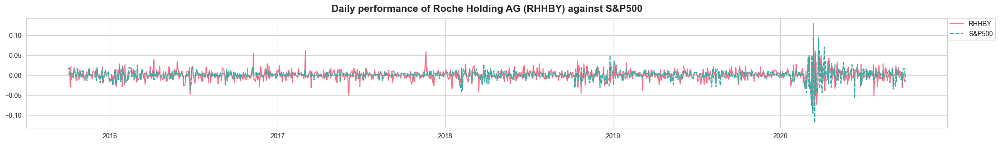

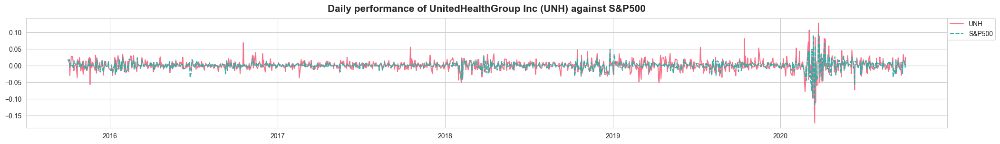

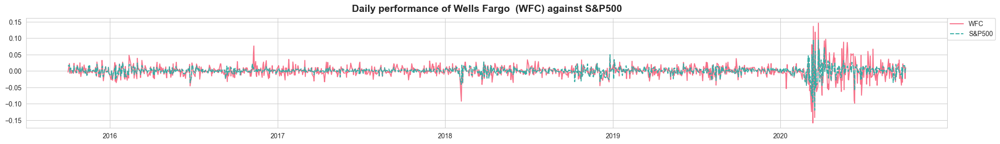

In [644]:
# Loop through each column in the list 't'
for col in t:

    # Create a new figure for plotting
    plt.figure(figsize=(25, 3))

    # Plot the daily performance of the current stock (col) against S&P500 using a line plot
    sns.lineplot(daily_return[[col, 'S&P500']], palette='husl')

    # Add a title to the plot with the name of the stock and a description of what it shows
    plt.title(f'Daily performance of {annex.loc[annex['Ticker'] == col, 'Company Name'].values[0]} ({col}) against S&P500', fontweight='bold', fontsize=15, pad=10)

    # Customize the legend box
    plt.legend(bbox_to_anchor=(1, 1), loc=2, borderaxespad=0.)

    # Remove the x-axis label to keep the focus on the plot
    plt.xlabel('')

    # Show the plot
    plt.show()

This code generates a heatmap showing the correlation among all stocks, including S&P500. The masking options are used to hide the upper triangular part of the matrix, which is redundant since the correlation matrix is symmetric.

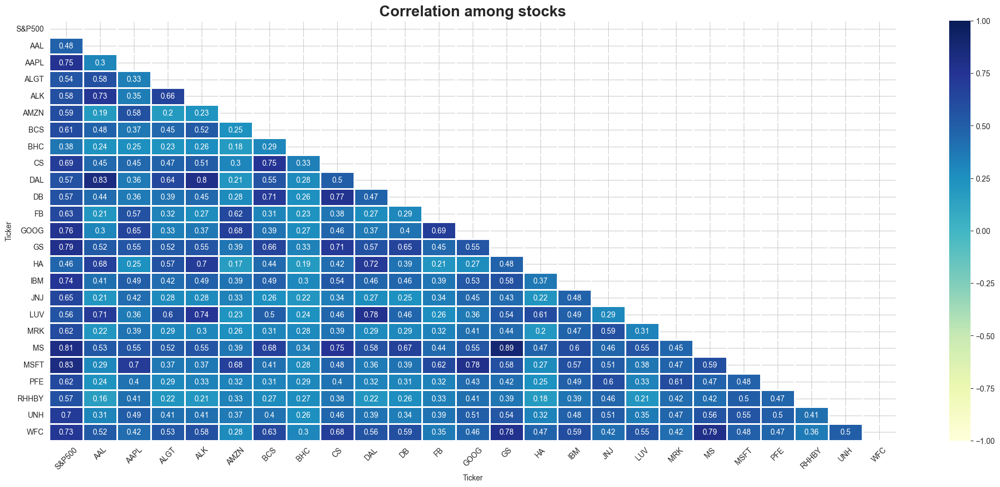

In [645]:
# Calculate the correlation matrix for all stocks, including S&P500, using Pearson's method
correlated_stocks = daily_return[['S&P500'] + t].corr(method = 'pearson')

# Create a new figure for plotting the heatmap
plt.figure(figsize=(25,10))

# Initialize an array of zeros with the same shape as the correlation matrix
mask = np.zeros_like(correlated_stocks)

# Set all elements above the diagonal to True (i.e., mask them)
mask[np.triu_indices_from(mask)] = True

# Plot the heatmap using seaborn and specify the color map, maximum value, minimum value, and masking options
sns.heatmap(correlated_stocks, cmap='YlGnBu', vmax=1.0, vmin=-1.0 , mask = mask, linewidths=1.0, annot=True)

# Rotate the y-axis tick labels for better readability
plt.yticks(rotation=0)

# Rotate the x-axis tick labels at a 45-degree angle for better readability
plt.xticks(rotation=45)

# Add a title to the plot
plt.title('Correlation among stocks', fontsize=20, fontweight='bold')

# Display the heatmap
plt.show()

#### Insights
- Microsoft and Google's stocks exhibit high correlation within the Technology sector.
- The stocks of Goldman Sachs, Morgan Stanley, and Wells Fargo demonstrate significant correlation within the Finance sector.
- American Airlines and Delta Air Lines display a higher degree of correlation compared to Alaska Air Group in the Aviation sector.
- Pharmaceutical sector stocks tend to have lower correlation relative to other sectors.

#### Daily Returns Dispersion (I)

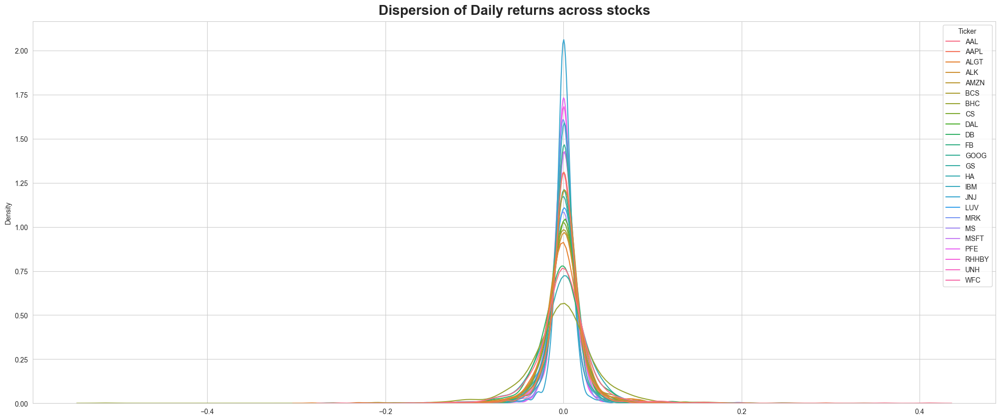

In [646]:
# Create a new figure for plotting the kernel density estimate (KDE) plot
plt.figure(figsize=(25,10))

# Plot the KDE of each stock in the list "t" using seaborn
sns.kdeplot(daily_return[t])

# Add a title to the plot
plt.title('Dispersion of Daily returns across stocks', fontsize=20, fontweight='bold', pad=10)

# Display the plot
plt.show()

#### Daily Returns Dispersion (II)

This code generates a series of 28 violin plots (7 rows x 4 columns) that show the distribution of each stock in the list t compared to S&P500. The split=True parameter splits the violin plot into two parts, with the right part showing the distribution of the individual stocks and the left part showing the distribution of S&P500.

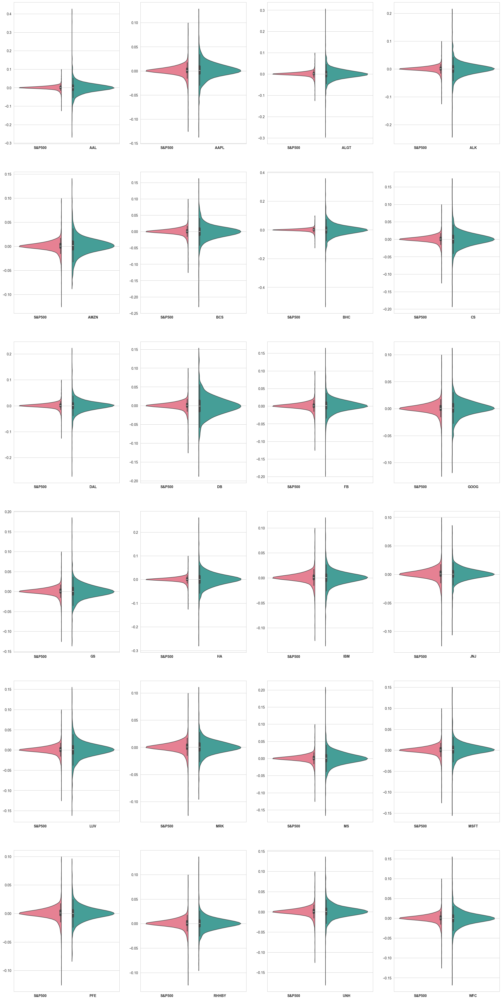

In [647]:
# Create a new figure for plotting violin plots
plt.figure(figsize=(25, 60))

# Loop through each stock in the list "t"
for col in t:

    # Increment the subplot index
    i+=1

    # Create a subplot with the current index
    plt.subplot(7, 4, i)

    # Plot a violin plot for the current stock and S&P500 using seaborn
    sns.violinplot(daily_return[['S&P500', col]], split=True, palette='husl')
    
    # Increase the font weight of x-ticks
    plt.xticks(fontweight='bold')
    
    plt.xlabel('')

# Display the plot
plt.show()

# Initialize the index to 0
i=0

#### Daily Returns Dispersion (III)

This code generates a series of 28 kernel density estimate (KDE) plots (7 rows x 4 columns) that show the distribution of each stock in the list t. The KDE plot is used to smooth out the data and create a continuous curve that represents the underlying distribution of the data.

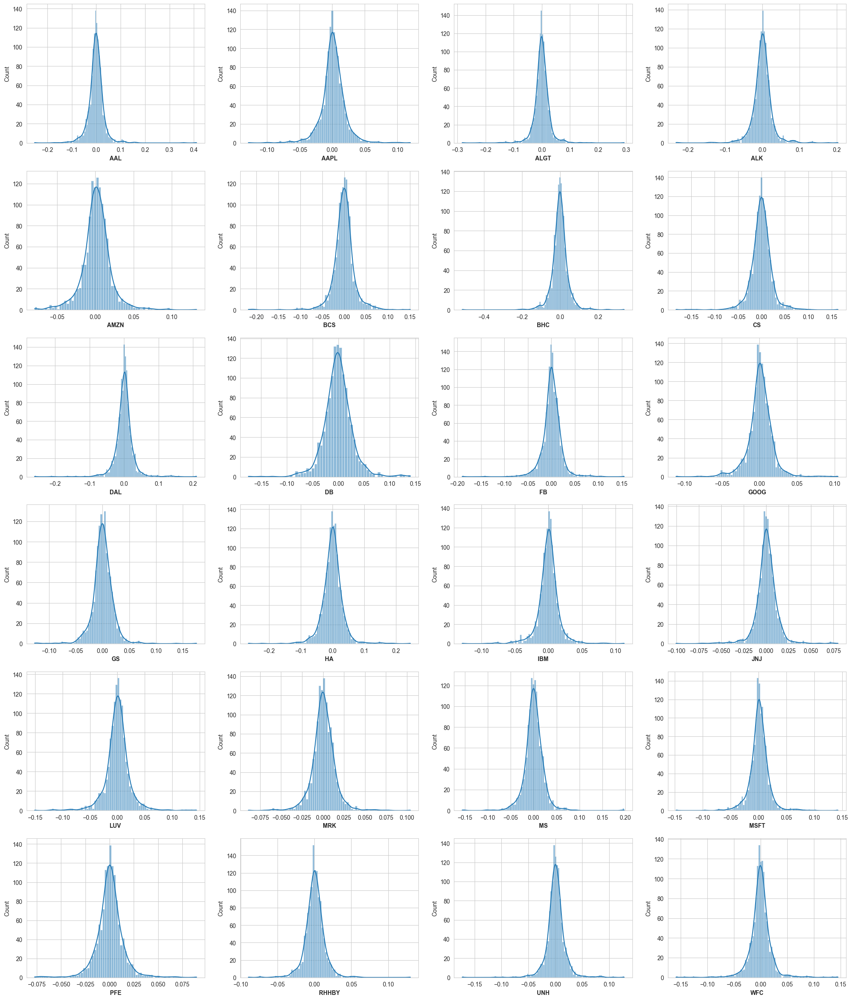

In [648]:
# Create a new figure for plotting kernel density estimate (KDE) plots
plt.figure(figsize=(25, 35))

# Loop through each stock in the list "t"
for col in t:
    
    # Increment the subplot index
    i+=1

    # Create a subplot with the current index
    plt.subplot(7, 4, i)

    # Plot a KDE plot for the current stock using seaborn
    sns.histplot(daily_return[col], kde=True)
    
    plt.xlabel(col, fontweight='bold')

# Display the plot
plt.show()

# Initialize the index to 0
i = 0

### Cumulative Returns

In [649]:
# Calculate the cumulative product of the daily returns for each stock, including S&P500
cum_daily_return = (1 + daily_return[['S&P500'] + t]).cumprod() - 1

# Get the last row of the cumulative daily return series
cum_daily_return.tail()

Ticker,S&P500,AAL,AAPL,ALGT,ALK,AMZN,BCS,BHC,CS,DAL,...,IBM,JNJ,LUV,MRK,MS,MSFT,PFE,RHHBY,UNH,WFC
Date,,,,,,,,,,,,,,,,,,,,,
2020-09-24,0.687575,-0.699745,2.950356,-0.442609,-0.555029,4.799259,-0.683544,-0.915256,-0.600664,-0.361154,...,-0.177589,0.552753,-0.040354,0.684221,0.479683,3.554808,0.123116,0.345575,1.509733,-0.546656
2020-09-25,0.714537,-0.686480,3.098558,-0.432241,-0.542565,4.943943,-0.686875,-0.914811,-0.606476,-0.344197,...,-0.171600,0.563379,-0.034106,0.679765,0.493333,3.658597,0.132224,0.349187,1.594117,-0.540435
2020-09-28,0.742159,-0.674490,3.196386,-0.416873,-0.532095,5.095503,-0.667555,-0.914978,-0.589041,-0.309844,...,-0.152239,0.578942,-0.004426,0.676322,0.535873,3.694911,0.142902,0.327815,1.600377,-0.536936
2020-09-29,0.733775,-0.687500,3.164628,-0.444490,-0.542939,5.039484,-0.669554,-0.917149,-0.591947,-0.325919,...,-0.157741,0.578405,-0.020828,0.658902,0.499683,3.646043,0.135992,0.305539,1.608267,-0.547823
2020-09-30,0.748085,-0.686480,3.227414,-0.450408,-0.543438,5.046878,-0.666223,-0.913474,-0.586135,-0.326580,...,-0.152657,0.597939,-0.023692,0.680170,0.534921,3.714862,0.152638,0.288682,1.673613,-0.542963


In [650]:
# Since we calculated returns the first row for Returns, hence Cumulative Returns will be null
# Delete the null rows as they are not relevant for our calculations
daily_return.dropna(axis=0, inplace = True)
cum_daily_return.dropna(axis=0, inplace = True)

In [651]:
# Print the first 5 rows of the DataFrame
daily_return.head()

Ticker,AAL,AAPL,ALGT,ALK,AMZN,BCS,BHC,CS,DAL,DB,...,JNJ,LUV,MRK,MS,MSFT,PFE,RHHBY,S&P500,UNH,WFC
Date,,,,,,,,,,,,,,,,,,,,,
2015-10-02,-0.014541,0.007301,-0.010964,-0.012090,0.022699,0.025316,0.015145,0.022831,-0.011892,0.023379,...,0.008157,-0.000781,0.015597,-0.002222,0.021520,0.038945,0.003010,0.014315,0.019038,-0.003499
2015-10-05,0.040383,0.003624,0.002180,0.020818,0.020919,0.013645,-0.103444,0.021104,0.046579,0.039057,...,0.008836,0.023971,0.021739,0.027362,0.023261,0.012092,0.003601,0.018290,0.006901,0.022435
2015-10-06,-0.051256,0.004784,-0.034527,-0.078853,-0.011404,-0.003205,0.015539,0.008744,-0.039821,0.007092,...,-0.014141,-0.033079,-0.027913,0.002168,0.002573,-0.020609,0.002691,-0.003588,-0.030088,-0.007251
2015-10-07,0.030947,-0.004761,0.025120,0.019321,0.008298,0.011576,0.023072,-0.002364,0.019960,0.013732,...,0.016699,0.018684,0.023092,0.017614,0.001069,0.015249,-0.029228,0.008036,0.003274,0.003075
2015-10-08,0.010939,-0.011554,-0.005518,-0.002764,-0.016201,0.005086,0.007890,-0.031201,-0.000652,-0.013894,...,0.001053,0.001292,0.001374,0.001822,0.013889,-0.006008,0.021505,0.008818,-0.003006,0.006706


In [652]:
# Print the last 5 rows of the DataFrame
cum_daily_return.tail()

Ticker,S&P500,AAL,AAPL,ALGT,ALK,AMZN,BCS,BHC,CS,DAL,...,IBM,JNJ,LUV,MRK,MS,MSFT,PFE,RHHBY,UNH,WFC
Date,,,,,,,,,,,,,,,,,,,,,
2020-09-24,0.687575,-0.699745,2.950356,-0.442609,-0.555029,4.799259,-0.683544,-0.915256,-0.600664,-0.361154,...,-0.177589,0.552753,-0.040354,0.684221,0.479683,3.554808,0.123116,0.345575,1.509733,-0.546656
2020-09-25,0.714537,-0.686480,3.098558,-0.432241,-0.542565,4.943943,-0.686875,-0.914811,-0.606476,-0.344197,...,-0.171600,0.563379,-0.034106,0.679765,0.493333,3.658597,0.132224,0.349187,1.594117,-0.540435
2020-09-28,0.742159,-0.674490,3.196386,-0.416873,-0.532095,5.095503,-0.667555,-0.914978,-0.589041,-0.309844,...,-0.152239,0.578942,-0.004426,0.676322,0.535873,3.694911,0.142902,0.327815,1.600377,-0.536936
2020-09-29,0.733775,-0.687500,3.164628,-0.444490,-0.542939,5.039484,-0.669554,-0.917149,-0.591947,-0.325919,...,-0.157741,0.578405,-0.020828,0.658902,0.499683,3.646043,0.135992,0.305539,1.608267,-0.547823
2020-09-30,0.748085,-0.686480,3.227414,-0.450408,-0.543438,5.046878,-0.666223,-0.913474,-0.586135,-0.326580,...,-0.152657,0.597939,-0.023692,0.680170,0.534921,3.714862,0.152638,0.288682,1.673613,-0.542963


Last record of the dataframe multiplied by 100 is giving us the percentage change of the stock prices for our entire period

In [653]:
# selecting the last row
per_cum_daily_return = cum_daily_return.tail(1)

# Round off the values by multiplying with 100
per_cum_daily_return = per_cum_daily_return * 100

# display the dataframe
per_cum_daily_return

Ticker,S&P500,AAL,AAPL,ALGT,ALK,AMZN,BCS,BHC,CS,DAL,...,IBM,JNJ,LUV,MRK,MS,MSFT,PFE,RHHBY,UNH,WFC
Date,,,,,,,,,,,,,,,,,,,,,
2020-09-30,74.808459,-68.64796,322.741369,-45.040827,-54.343762,504.68777,-66.622252,-91.347439,-58.613533,-32.658005,...,-15.265686,59.793934,-2.369175,68.017012,53.492057,371.486208,15.263822,28.868151,167.361278,-54.296267


In [654]:
# Resetting index
per_cum_daily_return.reset_index(inplace=True)

In [655]:
# Transposing dataframe
per_cum_daily_return = per_cum_daily_return.T

In [656]:
# Removing the date row & selecting only the stocks
per_cum_daily_return = per_cum_daily_return[1:]

In [657]:
# Renaming 0 column
per_cum_daily_return.rename(columns={0: 'Cumulative Returns'}, inplace=True)

In [658]:
# Sorting
per_cum_daily_return.sort_values(by='Cumulative Returns', ascending=False, inplace=True)

In [659]:
# Checking Datatype
per_cum_daily_return.dtypes

Cumulative Returns    object
dtype: object

In [660]:
# Changing Datatype
per_cum_daily_return['Cumulative Returns'] = pd.to_numeric(per_cum_daily_return['Cumulative Returns'])

In [661]:
# Rounding off to 2 decimals
per_cum_daily_return['Cumulative Returns'] = per_cum_daily_return['Cumulative Returns'].apply(lambda x: round(x, 2))

In [662]:
# Print the first 5 rows of the DataFrame
per_cum_daily_return.head()

,Cumulative Returns
Ticker,
AMZN,504.69
MSFT,371.49
AAPL,322.74
FB,187.96
UNH,167.36


#### Insight
- Amazon, Microsoft and Apple provided the highest cumulative returns when compared with other stocks.

### Annualized Returns

In [663]:
# Calculate descriptive statistics for the daily return data
daily_return.describe()

Ticker,AAL,AAPL,ALGT,ALK,AMZN,BCS,BHC,CS,DAL,DB,...,JNJ,LUV,MRK,MS,MSFT,PFE,RHHBY,S&P500,UNH,WFC
count,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,...,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000,1258.000000
mean,-0.000336,0.001322,-0.000047,-0.000256,0.001611,-0.000548,-0.000897,-0.000437,0.000042,-0.000529,...,0.000451,0.000245,0.000511,0.000578,0.001387,0.000209,0.000293,0.000517,0.000941,-0.000414
std,0.034725,0.018729,0.029101,0.026907,0.018969,0.025119,0.044551,0.022842,0.026478,0.027743,...,0.012459,0.022913,0.014067,0.021810,0.017539,0.013826,0.013514,0.012080,0.017810,0.020349
min,-0.252246,-0.128647,-0.283300,-0.232385,-0.079221,-0.218519,-0.514629,-0.182598,-0.259924,-0.174888,...,-0.100379,-0.151094,-0.088990,-0.156000,-0.147390,-0.077346,-0.089609,-0.119841,-0.172769,-0.158676
25%,-0.013623,-0.006179,-0.011305,-0.010721,-0.006716,-0.010787,-0.019678,-0.010442,-0.009714,-0.014976,...,-0.004277,-0.009222,-0.006240,-0.009023,-0.005893,-0.005856,-0.006237,-0.002938,-0.006644,-0.007917
50%,-0.000480,0.000951,-0.000363,0.000206,0.001636,0.000000,-0.000501,0.000000,0.000783,-0.001051,...,0.000493,0.000618,0.000245,0.000445,0.001225,0.000115,0.000229,0.000682,0.000809,-0.000362
75%,0.013233,0.009911,0.011630,0.010619,0.010765,0.010215,0.018022,0.010416,0.009781,0.013872,...,0.005921,0.009990,0.007616,0.010451,0.009161,0.006372,0.006919,0.005213,0.008161,0.007589
max,0.410970,0.119808,0.292428,0.203079,0.132164,0.151042,0.337444,0.163447,0.210171,0.140244,...,0.079977,0.144441,0.104080,0.197700,0.142169,0.089607,0.130118,0.093828,0.127989,0.145347


In [664]:
# Extracting only mean, std. dev., min and max values
daily_return_desc = daily_return.describe().loc[['mean', 'std', 'min', 'max']].T

In [665]:
# Renaming columns
daily_return_desc.rename({'mean': 'Avg. Daily Returns', 'std': 'Risk', 'min': 'Min', 'max': 'Max'}, axis=1, inplace=True)

In [666]:
# Sorting by Avg. Daily returns
daily_return_desc.sort_values(by='Avg. Daily Returns', ascending=False, inplace=True)

In [667]:
# Print the first 5 rows of the DataFrame
daily_return_desc.head()

,Avg. Daily Returns,Risk,Min,Max
Ticker,,,,
AMZN,0.001611,0.018969,-0.079221,0.132164
MSFT,0.001387,0.017539,-0.147390,0.142169
AAPL,0.001322,0.018729,-0.128647,0.119808
FB,0.001050,0.020354,-0.189609,0.155214
UNH,0.000941,0.017810,-0.172769,0.127989


In [668]:
# As per the industry practice here we take 252 days as the number of working days of a stock market
daily_return_desc['Annualized Returns'] = daily_return_desc['Avg. Daily Returns'] * 252

### Annualized Risk

In [669]:
# Calculate Annualized Risk
daily_return_desc['Annualized Risk'] = np.sqrt(252) * daily_return_desc['Risk']

### Sharpe Ratio

In [670]:
# Considering the risk-free rate as 0.75%
daily_return_desc['Sharpe Ratio'] = ((daily_return_desc['Annualized Returns'] - 0.0075) / daily_return_desc['Annualized Risk']) / 100       # Dividing by 100 to cancel the round-off

In [671]:
# Rounding off by multiplying with 100
daily_return_desc = daily_return_desc * 100

In [672]:
# Limiting values uto 2 decimal points
daily_return_desc = round(daily_return_desc, 2)

In [673]:
# Print the first 5 rows of the DataFrame
daily_return_desc.head()

,Avg. Daily Returns,Risk,Min,Max,Annualized Returns,Annualized Risk,Sharpe Ratio
Ticker,,,,,,,
AMZN,0.16,1.90,-7.92,13.22,40.59,30.11,1.32
MSFT,0.14,1.75,-14.74,14.22,34.95,27.84,1.23
AAPL,0.13,1.87,-12.86,11.98,33.32,29.73,1.10
FB,0.10,2.04,-18.96,15.52,26.45,32.31,0.80
UNH,0.09,1.78,-17.28,12.80,23.72,28.27,0.81


In [674]:
# Dataframe including annualized returns, risk, sharpe ratio and cumulative returns
stocks_final = pd.concat([daily_return_desc, per_cum_daily_return], axis=1)

# Print the first 10 rows of the DataFrame
stocks_final.head(10)

,Avg. Daily Returns,Risk,Min,Max,Annualized Returns,Annualized Risk,Sharpe Ratio,Cumulative Returns
Ticker,,,,,,,,
AMZN,0.16,1.90,-7.92,13.22,40.59,30.11,1.32,504.69
MSFT,0.14,1.75,-14.74,14.22,34.95,27.84,1.23,371.49
AAPL,0.13,1.87,-12.86,11.98,33.32,29.73,1.10,322.74
FB,0.10,2.04,-18.96,15.52,26.45,32.31,0.80,187.96
UNH,0.09,1.78,-17.28,12.80,23.72,28.27,0.81,167.36
GOOG,0.08,1.65,-11.10,10.45,21.02,26.23,0.77,140.41
MS,0.06,2.18,-15.60,19.77,14.55,34.62,0.40,53.49
S&P500,0.05,1.21,-11.98,9.38,13.04,19.18,0.64,74.81
MRK,0.05,1.41,-8.90,10.41,12.88,22.33,0.54,68.02


### Insight (1)
- AMZN gives 40.59% annual returns
- MSFT gives 34.95% annual returns
- AAPL gives 33.32% annual returns
- FB gives 26.45% annual returns
- UNH gives 23.72% annual returns
- GOOG gives 21.02% annual returns
- MS gives 14.55% annual returns

In [675]:
# Print information about the DataFrame, including its shape, columns, and data types
stocks_final.info()

<class 'pandas.core.frame.DataFrame'>
Index: 25 entries, AMZN to BHC
Data columns (total 8 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Avg. Daily Returns  25 non-null     float64
 1   Risk                25 non-null     float64
 2   Min                 25 non-null     float64
 3   Max                 25 non-null     float64
 4   Annualized Returns  25 non-null     float64
 5   Annualized Risk     25 non-null     float64
 6   Sharpe Ratio        25 non-null     float64
 7   Cumulative Returns  25 non-null     float64
dtypes: float64(8)
memory usage: 1.8+ KB


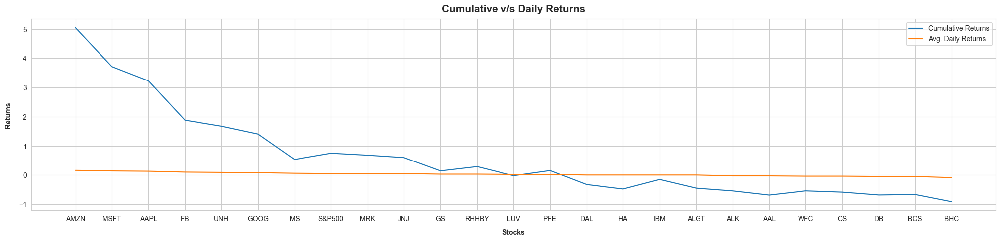

In [676]:
# Chart showing cumulative returns

# Create a new figure for plotting cumulative returns
plt.figure(figsize=(25, 5))

# Plot two line plots: Cumulative Returns and Average Daily Returns
sns.lineplot(data=stocks_final['Cumulative Returns'] / 100, label='Cumulative Returns')
sns.lineplot(data=stocks_final['Avg. Daily Returns'], label='Avg. Daily Returns')

# X-axis label
plt.xlabel('Stocks', fontweight='bold', labelpad=10)

# Y-axis label
plt.ylabel('Returns', fontweight='bold', labelpad=10)

# Chart Title
plt.title('Cumulative v/s Daily Returns', fontweight='bold', fontsize=15, pad=10)

# Display the plot
plt.show()

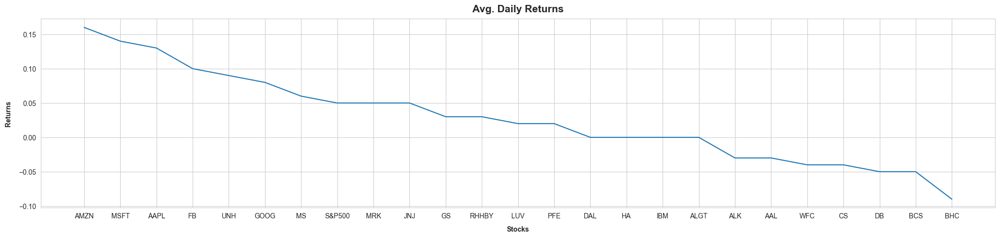

In [677]:
# Chart showing Daily returns

# Create a new figure for plotting daily returns
plt.figure(figsize=(25, 5))

# Plot line plot to show Average Daily Returns
sns.lineplot(data=stocks_final['Avg. Daily Returns'])

# X-axis label
plt.xlabel('Stocks', fontweight='bold', labelpad=10)

# Y-axis label
plt.ylabel('Returns', fontweight='bold', labelpad=10)

# Chart Title
plt.title('Avg. Daily Returns', fontweight='bold', fontsize=15, pad=10)

# Display the plot
plt.show()

### Insight (2)
- Amazon, Microsoft, Apple, Facebook, United Health, Google and Microsoft have given better Daily returns

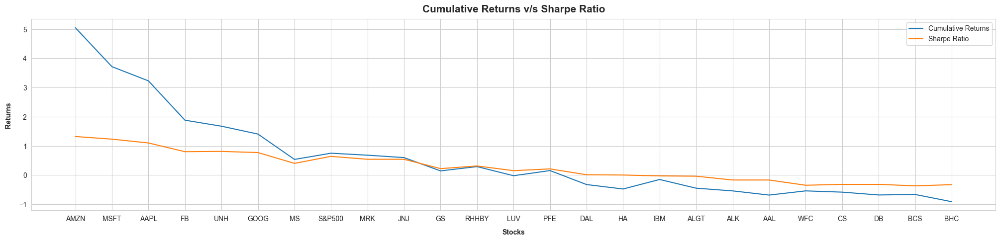

In [678]:
# Chart showing cumulative returns and Sharpe ratio

# Create a new figure
plt.figure(figsize=(25, 5))

# Plot two line plots: Cumulative Returns and Sharpe Ratio
sns.lineplot(data=stocks_final['Cumulative Returns'] / 100, label='Cumulative Returns')
sns.lineplot(data=stocks_final['Sharpe Ratio'], label='Sharpe Ratio')

# X-axis label
plt.xlabel('Stocks', fontweight='bold', labelpad=10)

# Y-axis label
plt.ylabel('Returns', fontweight='bold', labelpad=10)

# Chart Title
plt.title('Cumulative Returns v/s Sharpe Ratio', fontweight='bold', fontsize=15, pad=10)

# Display the plot
plt.show()

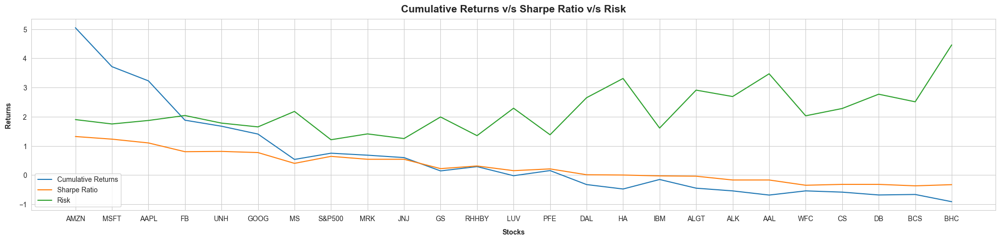

In [679]:
# Chart showing cumulative returns, Sharpe ratio, Annualized Risk and Risk

# Create a new figure
plt.figure(figsize=(25, 5))

# Plot three line plots: Cumulative Returns, Sharpe Ratio and Risk
sns.lineplot(data=stocks_final['Cumulative Returns'] / 100, label='Cumulative Returns')
sns.lineplot(data=stocks_final['Sharpe Ratio'], label='Sharpe Ratio')
sns.lineplot(data=stocks_final['Risk'], label='Risk')

# X-axis label
plt.xlabel('Stocks', fontweight='bold', labelpad=10)

# Y-axis label
plt.ylabel('Returns', fontweight='bold', labelpad=10)

# Chart Title
plt.title('Cumulative Returns v/s Sharpe Ratio v/s Risk', fontweight='bold', fontsize=15, pad=10)

# Display the plot
plt.show()

In [680]:
# Export Stocks Final Dataset
stocks_final.to_excel(final_data, sheet_name='Stock Data - Analysis')

# Save to Excel file
final_data.close()

## Portfolio Analysis

### Patrick Jyerngar
- Mr. Patrick Jyengar wants to double his investment in the span on 5 years.
- He wants to invest in low risk stocks which would fetch him decent returns.
- As per his profile Low risk stocks like **JNJ, RHHBY and MRK** is suitable to invest on.
- But overall returns with these three stocks wouldn't reach the target what Mr. Patrick is investing for.
- So one portion of his wealth can be invested on **MSFT** to gain the desired returns.

Let's calculate the Risk and Returns associated with the above-mentioned portfolio.

In [681]:
# Stocks for Patrick
stocks_patrick = ['MSFT', 'JNJ', 'RHHBY' ,'MRK']

In [682]:
# Use the `loc` method to select only the rows and columns that correspond to the stocks in the `stocks_patrick` list
portfolio_patrick = stocks.loc[:, stocks_patrick].copy()

In [683]:
# Display the first 5 rows of the portfolio data
portfolio_patrick.head()

Ticker,MSFT,JNJ,RHHBY,MRK
Date,,,,
2015-10-01,44.610001,93.169998,33.220001,49.369999
2015-10-02,45.570000,93.930000,33.320000,50.139999
2015-10-05,46.630001,94.760002,33.439999,51.230000
2015-10-06,46.750000,93.419998,33.529999,49.799999
2015-10-07,46.799999,94.980003,32.549999,50.950001


#### Daily Returns

The percentage change in the price of the stock from the previous day is called Daily return . This can be calculated using the percentage change in the price on a daily basis.

In [684]:
# Calculate daily returns for Patrick's portfolio using the pct_change method
daily_return_patrick = portfolio_patrick.pct_change()

# Display the first 10 rows of the daily returns data
daily_return_patrick.head(10)

Ticker,MSFT,JNJ,RHHBY,MRK
Date,,,,
2015-10-01,NaN,NaN,NaN,NaN
2015-10-02,0.021520,0.008157,0.003010,0.015597
2015-10-05,0.023261,0.008836,0.003601,0.021739
2015-10-06,0.002573,-0.014141,0.002691,-0.027913
2015-10-07,0.001069,0.016699,-0.029228,0.023092
2015-10-08,0.013889,0.001053,0.021505,0.001374
2015-10-09,-0.007165,0.003050,-0.011729,-0.001372
2015-10-12,-0.002335,0.006501,0.004260,-0.004711
2015-10-13,-0.002340,-0.005626,0.005455,-0.024453


#### Average Daily Returns

In [685]:
# Calculate the average daily return for Patrick's portfolio using the mean method
avg_daily_return_patrick = daily_return_patrick.mean()

# Display the first 5 rows of the average daily returns data
avg_daily_return_patrick.head()

Ticker
MSFT     0.001387
JNJ      0.000451
RHHBY    0.000293
MRK      0.000511
dtype: float64

##### Remarks
- MSFT is the best performed stock

#### Risk

In [686]:
# Calculate the risk (standard deviation) of daily returns for Patrick's portfolio using the std method
risk_daily_return_patrick = daily_return_patrick.std()

# Display the first 5 rows of the risk data
risk_daily_return_patrick.head()

Ticker
MSFT     0.017539
JNJ      0.012459
RHHBY    0.013514
MRK      0.014067
dtype: float64

#### Portfolio Daily Returns

The weighted average can be calculated to determine the return from the portfolio on a daily basis.

In [687]:
# Equal weightage
daily_return_patrick['portfolio_daily_return'] = daily_return_patrick.dot(np.full(len(stocks_patrick), 1 / len(stocks_patrick)))

In [688]:
# Display the first 10 rows of the risk data
daily_return_patrick.head(10)

Ticker,MSFT,JNJ,RHHBY,MRK,portfolio_daily_return
Date,,,,,
2015-10-01,NaN,NaN,NaN,NaN,NaN
2015-10-02,0.021520,0.008157,0.003010,0.015597,0.012071
2015-10-05,0.023261,0.008836,0.003601,0.021739,0.014359
2015-10-06,0.002573,-0.014141,0.002691,-0.027913,-0.009197
2015-10-07,0.001069,0.016699,-0.029228,0.023092,0.002908
2015-10-08,0.013889,0.001053,0.021505,0.001374,0.009455
2015-10-09,-0.007165,0.003050,-0.011729,-0.001372,-0.004304
2015-10-12,-0.002335,0.006501,0.004260,-0.004711,0.000929
2015-10-13,-0.002340,-0.005626,0.005455,-0.024453,-0.006741


#### Total Portfolio Return

In [689]:
# Calculate the total daily return for Patrick's portfolio by multiplying the average daily return by the number of stocks
total_daily_return_patrick = np.full(len(stocks_patrick), 1 / len(stocks_patrick)) * avg_daily_return_patrick

In [690]:
# Calculate the total return for Patrick's portfolio by summing the total daily returns
portfolio_patrick_return = np.sum(total_daily_return_patrick)

In [691]:
# Round the total return to three decimal places and multiply by 100 to get the percentage return
round(portfolio_patrick_return * 100, 3)

0.066

##### Remarks
The Average Daily Returns of Portfolio is 0.06%

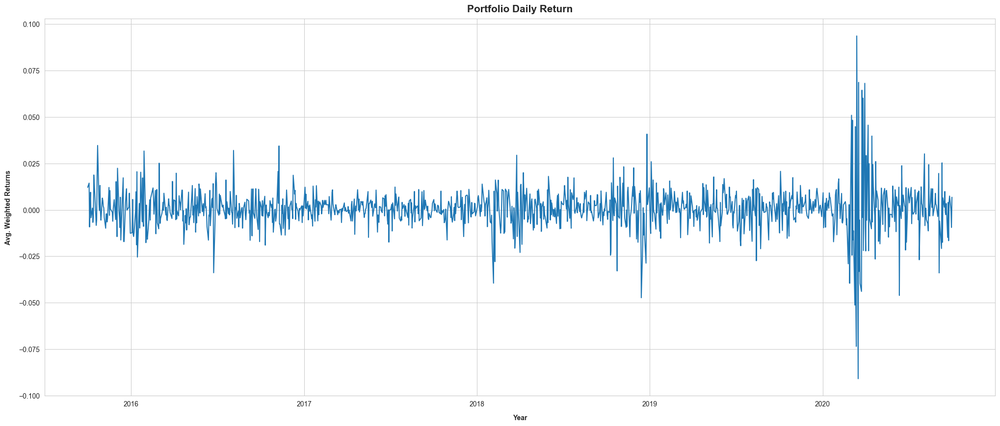

In [692]:
# Plotting Average Daily Returns

# Create a new figure for plotting average daily returns
plt.figure(figsize=(25, 10))

# Plot the average daily returns using a line plot
sns.lineplot(data=daily_return_patrick, x='Date', y='portfolio_daily_return')

# Set the title of the chart
plt.title('Portfolio Daily Return', fontweight='bold', fontsize=15, pad=10)

# Set the x-axis label
plt.xlabel('Year', fontweight='bold', labelpad=10)

# Set the y-axis label
plt.ylabel('Avg. Weighted Returns', fontweight='bold', labelpad=10)

# Show the plot
plt.show()

##### Remarks
There's a large variation of prices in the Year 2018 and 2019.

#### Cumulative Returns

In [693]:
# Calculate the cumulative return for Patrick's portfolio by taking the cumulative product of (1 + daily returns)
cum_return_patrick = (1 + daily_return_patrick).cumprod()

# Display the last few rows of the cumulative returns data using the tail method
cum_return_patrick.tail()

Ticker,MSFT,JNJ,RHHBY,MRK,portfolio_daily_return
Date,,,,,
2020-09-24,4.554808,1.552753,1.345575,1.684221,2.106791
2020-09-25,4.658597,1.563379,1.349187,1.679765,2.122417
2020-09-28,4.694911,1.578942,1.327815,1.676322,2.122342
2020-09-29,4.646043,1.578405,1.305539,1.658902,2.102224
2020-09-30,4.714862,1.597939,1.288682,1.680170,2.116465


##### Remarks
The portfolio has given a cumulative returns of 2.12% over the last 5 years.

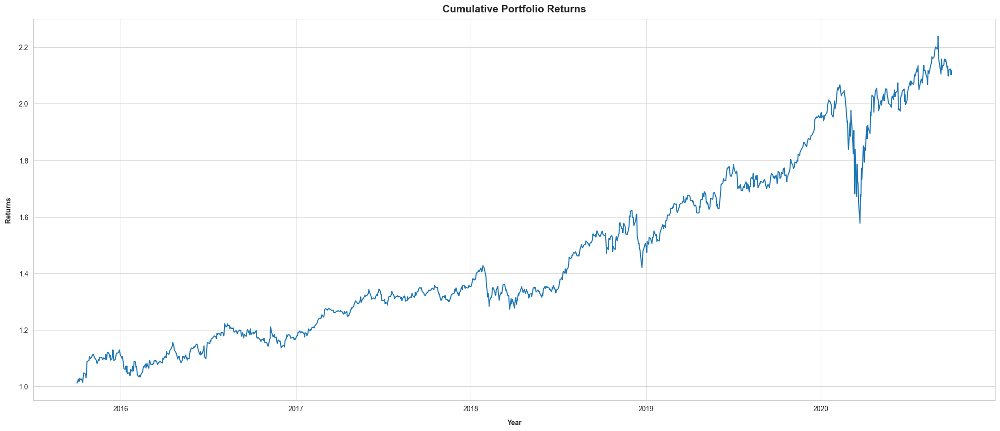

In [694]:
# Plotting Cumulative Daily Returns

# Create a new figure for plotting cumulative daily returns
plt.figure(figsize=(25, 10))

# Plot the cumulative daily returns using a line plot
sns.lineplot(data=cum_return_patrick, x='Date', y='portfolio_daily_return')

# Set the title of the chart
plt.title('Cumulative Portfolio Returns', fontweight='bold', fontsize=15, pad=10)

# Set the x-axis label
plt.xlabel('Year', fontweight='bold', labelpad=10)

# Set the y-axis label
plt.ylabel('Returns', fontweight='bold', labelpad=10)

# Show the plot
plt.show()

#### Portfolio Risk - Portfolio Standard Deviation

To calculate the portfolio standard deviation, we require three key components:

- A portfolio weight array, which is already available.
- The daily covariance matrix, which needs to be annualized by multiplying it by 252 (the number of trading days in a year).
- The transpose of the portfolio weight array.

In [695]:
# Covariance matrix for the portfolio

# Calculate the covariance matrix for the portfolio (Patrick's returns)
portfolio_patrick_covariance_matrix = daily_return_patrick.drop(columns=['portfolio_daily_return']).copy()          # Dropping portfolio_daily_return column

In [696]:
# Calculate the sample covariance matrix using pandas' built-in cov() function
# The result is a square array with shape (n_samples, n_features) where n_samples is the number of samples and n_features is the number of features
portfolio_patrick_covariance_matrix = (portfolio_patrick_covariance_matrix.cov()) * 252

In [697]:
# Final covariance matrix for the portfolio
portfolio_patrick_covariance_matrix

Ticker,MSFT,JNJ,RHHBY,MRK
Ticker,,,,
MSFT,0.077524,0.028277,0.029796,0.029374
JNJ,0.028277,0.039117,0.019560,0.025844
RHHBY,0.029796,0.019560,0.046023,0.020306
MRK,0.029374,0.025844,0.020306,0.049865


In [698]:
# Calculate the portfolio variance using matrix operations
portfolio_patrick_variance = np.dot(
    # Vector of ones (len(stocks_patrick) elements)
    np.full(len(stocks_patrick), 1 / len(stocks_patrick)),

    # Matrix product: portfolio_covariance_matrix * vector_of_ones
    np.dot(portfolio_patrick_covariance_matrix, np.full(len(stocks_patrick), 1 / len(stocks_patrick)))
)

In [699]:
# Calculate the portfolio risk (standard deviation) using the variance
portfolio_patrick_risk = np.sqrt(portfolio_patrick_variance)

# Multiply by 100 to convert from standard deviation to percentage
portfolio_patrick_risk * 100

18.00773538749593

#### Sharpe Ratio

In [700]:
# Calculate the Sharpe Ratio for Patrick's portfolio
portfolio_patrick_sharpe = ((
                                # Mean return of the portfolio (minus the risk-free rate, assumed to be 0)
                                daily_return_patrick['portfolio_daily_return'].mean() -
    
                                # Mean return of S&P500 index (benchmark)
                                daily_return['S&P500'].mean()
                            ) / 

                            # Standard deviation of the portfolio returns
                            daily_return_patrick['portfolio_daily_return'].std())

# Final Sharpe Ratio for Patrick's portfolio
portfolio_patrick_sharpe

0.012596079178261301

#### Annualized Sharpe Ratio

In [701]:
# Annualized Patrick's Sharpe Ratio to make it comparable to annual returns
portfolio_patrick_sharpe_annualized = (
        # Scaling factor for daily values to convert to annual values
        (252**0.5) 
        *
        # Sharpe Ratio calculated earlier
        portfolio_patrick_sharpe
)

# Final Annualized Sharpe Ratio for Patrick' s portfolio
portfolio_patrick_sharpe_annualized

0.19995655800094939

#### Total RoI from the Portfolio

In [702]:
# Calculate the total return for Patrick's portfolio
invested_amount = 500000                                                            # Initial investment amount

In [703]:
# Cumulative return at the end of the period
cum_return_patrick_1 = cum_return_patrick.iloc[-1, -1]

In [704]:
# Calculate the expected return on the initial investment
expected_return_patrick = invested_amount * cum_return_patrick_1
expected_return_patrick

1058232.526596431

In [705]:
# Calculate the expected earnings (profit) for Patrick' s portfolio
expected_earning_patrick = expected_return_patrick - invested_amount
expected_earning_patrick

558232.5265964309

##### Remarks
Having invested 500,000 USD in equities, Mr. Patrick Jyengar's portfolio will have yielded a return of 1.05M USD after a 5-year period, resulting in a gain of 558K USD on his initial investment.

### Peter Jyengar
- He prefers high-return investments, consistent with his risk tolerance.
- He believes that occasional losses can be mitigated by bouncing back from them.
- He wants to invest $1 million from the company's cash and cash equivalents in high-margin stocks.
- His target is to generate high returns within 5 years, which will support the company's inorganic expansion.
- According to his investment profile, high-risk/high-return stocks like **AMZN** are suitable for investment.
- He expects these stocks to deliver maximum returns and effectively manage risk.


Let's calculate the Risk and Returns associated with the above-mentioned portfolio.

In [706]:
# Define the list of stock tickers for Peter' s portfolio
stocks_peter = ['AMZN']

In [707]:
# Extract the relevant columns from the 'stocks' DataFrame that match Peter's stocks
portfolio_peter = stocks.loc[:, stocks_peter].copy()

In [708]:
# Print the first 5 rows (head) of Peter's portfolio data
portfolio_peter.head()

Ticker,AMZN
Date,
2015-10-01,520.719971
2015-10-02,532.539978
2015-10-05,543.679993
2015-10-06,537.479980
2015-10-07,541.940002


#### Daily Returns

The percentage change in the price of the stock from the previous day is called Daily return. This can be calculated using the percentage change in the price on a daily basis.

In [709]:
# Calculate daily returns for Peter's portfolio using the pct_change() method
daily_return_peter = portfolio_peter.pct_change()

# Print the first 10 rows of daily returns data
daily_return_peter.head(10)

Ticker,AMZN
Date,
2015-10-01,NaN
2015-10-02,0.022699
2015-10-05,0.020919
2015-10-06,-0.011404
2015-10-07,0.008298
2015-10-08,-0.016201
2015-10-09,0.012454
2015-10-12,0.019248
2015-10-13,-0.002345


#### Average Daily Returns

In [710]:
# Calculate the average daily return for Peter's portfolio
avg_daily_return_peter = daily_return_peter.mean()

# Print the average daily returns data
avg_daily_return_peter

Ticker
AMZN    0.001611
dtype: float64

#### Risk

In [711]:
# Calculate the daily return risk (standard deviation) for Peter's portfolio
risk_daily_return_peter = daily_return_peter.std()

# Print the daily return risk data
risk_daily_return_peter

Ticker
AMZN    0.018969
dtype: float64

#### Portfolio Daily Returns

The weighted average can be calculated to determine the return from the portfolio on a daily basis. However, since we are considering only one stock i.e. AMZN, the weighted average doesn't matter.

#### Total Portfolio Return

In [712]:
# Calculate the total daily return for Peter's portfolio
total_daily_return_peter = np.full(len(stocks_peter), 1 / len(stocks_peter)) * avg_daily_return_peter

In [713]:
# Calculate the cumulative total return for Peter's portfolio
portfolio_peter_return = np.sum(total_daily_return_peter)

In [714]:
# Convert the total return to a percentage and round it to two decimal places
round(portfolio_peter_return * 100, 2)

0.16

##### Remarks
The Average Daily Returns of Portfolio is 0.16%

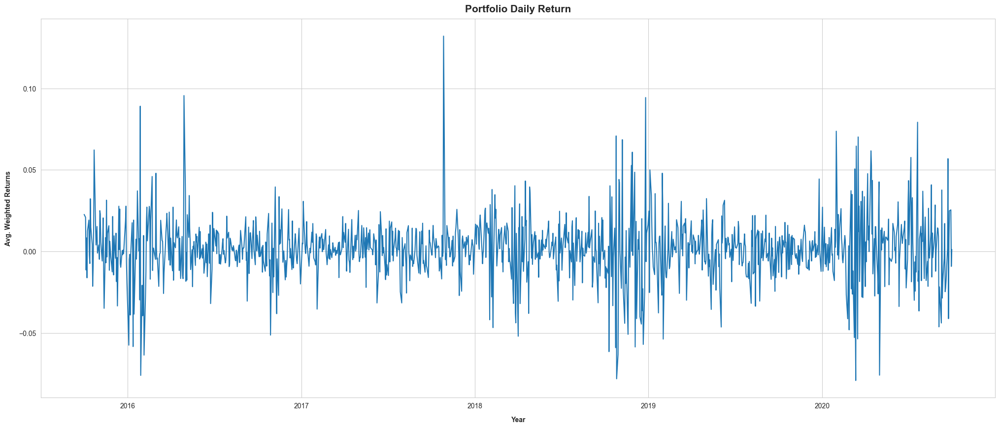

In [715]:
# Plotting Average Daily Returns

# Create a plot to visualize the average daily returns for Peter's portfolio
plt.figure(figsize=(25, 10))                                                                            # Set the figure size to 25 inches wide and 10 inches tall

# Plot the average daily returns using seaborn's lineplot function
sns.lineplot(data=daily_return_peter, x='Date', y='AMZN')                                               # Use 'Date' as the x-axis and 'AMZN' as the y-axis

# Add a title to the plot with bold font and a size of 15 points
plt.title('Portfolio Daily Return', fontweight='bold', fontsize=15, pad=10)                             # The title will be centered at the top of the plot

# Label the x-axis with 'Year' in bold font and add some padding for better readability
plt.xlabel('Year', fontweight='bold', labelpad=10)                                                      # The label will be moved away from the axis by 10 points to improve legibility

# Label the y-axis with 'Avg. Weighted Returns' in bold font, also adding some padding
plt.ylabel('Avg. Weighted Returns', fontweight='bold', labelpad=10)                                     # The label will be moved away from the axis by 10 points to improve legibility

# Display the plot using plt.show()
plt.show()

##### Remarks
There's a large variation of prices since the end of 2017.

#### Cumulative Returns

We are essentially calculating the cumulative return by adding 1 to each day's return and then cumulatively multiplying them together. This gives us the total return for the portfolio over the given period of time.

In [716]:
# Calculate the cumulative return for Peter's portfolio by adding 1 to the daily returns and then cumulatively multiplying them
cum_return_peter = (1 + daily_return_peter).cumprod()

# Show the last few rows of the cumulative return data using the tail() function
cum_return_peter.tail()

Ticker,AMZN
Date,
2020-09-24,5.799259
2020-09-25,5.943943
2020-09-28,6.095503
2020-09-29,6.039484
2020-09-30,6.046878


##### Remarks
The portfolio has given a cumulative returns of 6.05% over the last 5 years.

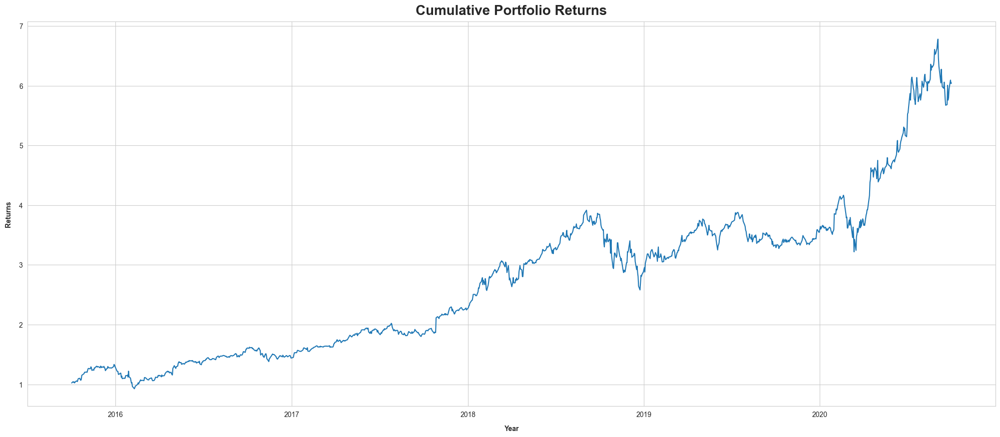

In [717]:
# Plotting Cumulative Daily Returns

# Create a plot to visualize the cumulative daily returns for Peter's portfolio
plt.figure(figsize=(25, 10))                                                                    # Set the figure size to 25 inches wide and 10 inches tall

# Plot the cumulative daily returns using seaborn's lineplot function
sns.lineplot(data=cum_return_peter, x='Date', y='AMZN')                                         # Use 'Date' as the x-axis and 'AMZN' as the y-axis

# Add a title to the plot with bold font and a size of 20 points
plt.title('Cumulative Portfolio Returns', fontweight='bold', fontsize=20, pad=10)               # The title will be centered at the top of the plot

# Label the x-axis with 'Year' in bold font and add some padding for better readability
plt.xlabel('Year', fontweight='bold', labelpad=10)                                              # The label will be moved away from the axis by 10 points to improve legibility

# Label the y-axis with 'Returns' in bold font, also adding some padding
plt.ylabel('Returns', fontweight='bold', labelpad=10)                                           # The label will be moved away from the axis by 10 points to improve legibility

# Display the plot using plt.show()
plt.show()          

#### Portfolio Risk - Portfolio Standard Deviation

To calculate the portfolio standard deviation, we require three key components:

- A portfolio weight array, which is already available.
- The daily covariance matrix, which needs to be annualized by multiplying it by 252 (the number of trading days in a year).
- The transpose of the portfolio weight array.

In [718]:
# Covariance matrix for the portfolio

# Calculate the covariance matrix for Peter's portfolio by multiplying the daily return covariance by 252 (assuming daily returns)
portfolio_peter_covariance_matrix = (daily_return_peter.cov()) * 252

In [719]:
# Print the portfolio's covariance matrix
portfolio_peter_covariance_matrix

Ticker,AMZN
Ticker,
AMZN,0.090671


In [720]:
# Calculate the variance of the portfolio by performing matrix operations
portfolio_peter_variance = np.dot(
    np.full(len(stocks_peter), 1 / len(stocks_peter)),
    np.dot(portfolio_peter_covariance_matrix, np.full(len(stocks_peter), 1 / len(stocks_peter)))
)

In [721]:
# Calculate the standard deviation (risk) of the portfolio
portfolio_peter_risk = np.sqrt(portfolio_peter_variance)
portfolio_peter_risk * 100

30.111660201498943

#### Sharpe Ratio

In [722]:
# Assuming that the risk-free rate is zero
# Calculate the Sharpe ratio for Peter's portfolio
portfolio_peter_sharpe = (daily_return_peter['AMZN'].mean() - daily_return['S&P500'].mean()) / daily_return_peter['AMZN'].std()
portfolio_peter_sharpe

0.05762416264976624

#### Annualized Sharpe Ratio

In [723]:
# Annualize the Sharpe ratio for Peter's portfolio by multiplying it by the square root of the number of trading days in a year (252)
portfolio_peter_sharpe_annualized = (252**0.5) * portfolio_peter_sharpe
portfolio_peter_sharpe_annualized

0.9147552232777095

#### Total RoI from the Portfolio

In [724]:
# Define the initial investment amount (in this case, $1,000,000)
invested_amount = 1000000

In [725]:
# Get the cumulative return for Peter's portfolio as of the last day
cum_return_peter_1 = cum_return_peter.iloc[-1, -1]

In [726]:
# Calculate the expected return for Peter's portfolio by multiplying the initial investment amount by the cumulative return
expected_return_peter = invested_amount * cum_return_peter_1
expected_return_peter

6046877.6988774445

In [727]:
# Calculate the expected earnings for Peter's portfolio by subtracting the initial investment amount from the expected return
expected_earning_peter = expected_return_peter - invested_amount
expected_earning_peter

5046877.6988774445

##### Remarks
Having invested 1,000,000 USD in equities, Mr. Peter Jyengar's portfolio will have yielded a return of 6.05M USD after a 5-year period, resulting in a gain of 504K USD on his initial investment.